In [1]:
import multiprocessing
from sklearn.cluster import KMeans
import pandas as pd
import numpy as np
import seaborn as sns
import scipy.stats as stats
from scipy.spatial.distance import euclidean
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.optimizers import Adam
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.tsa.stattools import acf
from sklearn.model_selection import train_test_split
from tensorflow.keras.losses import MeanSquaredError
from tensorflow import gather
import tensorflow as tf
from sklearn.base import BaseEstimator, TransformerMixin
import collections as co
import torch
from torch import nn
from scipy.signal import welch
import torch.optim as optim
from sklearn.model_selection import KFold
import signatory
import math
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
import rpy2.robjects as robjects
from rpy2.robjects import r
from rpy2.robjects import pandas2ri
from pykrige.ok import OrdinaryKriging
from scipy.interpolate import griddata
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io.shapereader import natural_earth, Reader
import torch.nn.functional as F
import itertools
from matplotlib.lines import Line2D
import statsmodels.api as sm
from scipy.spatial.distance import pdist
from scipy.spatial.distance import squareform


multiprocessing.cpu_count()


12

# Read NWP file

In [3]:
file_path='greatlakesregion/Long_C2_FR.RData'
r['load'](file_path)

pandas2ri.activate()
nwp_long_fine = robjects.conversion.rpy2py(r['Long_C2_FR'])

print(f'Longitude shape: {nwp_long_fine.shape}')

file_path='greatlakesregion/Lat_C2_FR.RData'
r['load'](file_path)

pandas2ri.activate()
nwp_lat_fine = robjects.conversion.rpy2py(r['Lat_C2_FR'])

print(f'Latitude shape: {nwp_lat_fine.shape}')

file_path = 'greatlakesregion/ws.nwp.JAN12.C2grid.FiRes.RData'
r['load'](file_path)

pandas2ri.activate()
nwp_jan12_fine = robjects.conversion.rpy2py(r['ws.nwp.JAN12.C2grid'])
nwp_jan12_fine= nwp_jan12_fine[:,:,24:]
print(f'Spatio temporal NWP data: {nwp_jan12_fine.shape}')


Longitude shape: (49, 68)
Latitude shape: (49, 68)
Spatio temporal NWP data: (49, 68, 695)


In [4]:
#(time*space)
k1 = nwp_jan12_fine.shape[0]  
k2 = nwp_jan12_fine.shape[1] 
kT = nwp_jan12_fine.shape[2]  
fine_nwp_JAN12 = np.zeros((k1 * k2,kT))

# Populate the new 2D array
for t in range(kT):
   fine_nwp_JAN12[:,t] = nwp_jan12_fine[:, :, t].T.flatten()

# Check the shape of the new array
print(f'spatio temporal data shape: {fine_nwp_JAN12.shape}')

hours=15
length = (fine_nwp_JAN12.shape[1]// hours)
print("Number of iid samples")
print(length) #59
remainder = fine_nwp_JAN12.shape[1] % hours
print("number of samples to discard in each location")
print(remainder) #11
# Handle if there is remainder (missing data)
if remainder > 0:
    # Trim the data if there's leftover and we want only full samples
    flattened_trimmed_nwp = fine_nwp_JAN12[:,:-remainder]
else:
    flattened_trimmed_nwp = flattened
print(f"Final time*space input shape: {flattened_trimmed_nwp.shape}")

reshaped_array =flattened_trimmed_nwp.T.reshape(length, hours, flattened_trimmed_nwp.shape[0])
nwp_tensor = torch.tensor(reshaped_array, dtype=torch.float32)

# Output tensor shape
print(f'NWP tensor: {nwp_tensor.shape}')


spatio temporal data shape: (3332, 695)
Number of iid samples
46
number of samples to discard in each location
5
Final time*space input shape: (3332, 690)
NWP tensor: torch.Size([46, 15, 3332])


In [5]:
#Flatten lat and lon
lat_flat = nwp_lat_fine.T.flatten()  # Shape (3332,)
long_flat = nwp_long_fine.T.flatten()  # Shape (3332,)

# Check shapes
print(f"Lat shape: {lat_flat.shape}")
print(f"Lon shape: {long_flat.shape}")

# Repeat lat and lon to match the number of time steps and hours
lat_repeated = np.tile(lat_flat, (length, hours, 1))  # Shape (length, hours, 3332)
lon_repeated = np.tile(long_flat, (length, hours, 1))  # Shape (length, hours, 3332)

#Convert to PyTorch tensors
lat_tensor = torch.tensor(lat_repeated, dtype=torch.float32)
lon_tensor = torch.tensor(lon_repeated, dtype=torch.float32)


Lat shape: (3332,)
Lon shape: (3332,)


# Read ASOS observations

In [7]:
file_path = 'greatlakesregion/wd.obs1.JAN12.RData'
r['load'](file_path)

obs_jan12 = robjects.conversion.rpy2py(r['wd.obs.JAN12'])
print(f"Total observation stations: {obs_jan12.shape}")

subregobs2 = [26,18,8,22,14,31,13,20,11,23,29,2]
y=[x - 1 for x in subregobs2]
obs_jan12_subreg2=obs_jan12[:,y]
print(f"Cluster 2 observation stations: {obs_jan12_subreg2.shape}")

length = (obs_jan12_subreg2.shape[0]// hours)
print(f"Number of iid samples: {length}")
remainder = obs_jan12_subreg2.shape[0] % hours
print(f"number of samples to discard in each location: {remainder}")

# Handle if there is remainder (missing data)
if remainder > 0:
    # Trim the data if there's leftover and we want only full samples
    flattened_trimmed_obs = obs_jan12_subreg2[:-remainder,:]
else:
    flattened_trimmed_obs = flattened

print(f'Obs trimmed data: {flattened_trimmed_obs.shape}')
reshaped_array =flattened_trimmed_obs.reshape(length, hours, len(subregobs2))
obs_tensor = torch.tensor(reshaped_array, dtype=torch.float32)
print(f'Obs tensor: {obs_tensor.shape}') #last index is location 

lat_obs=[44.63806 ,44.35917, 43.76944, 43.15611, 43.21194, 43.76944, 42.76111, 42.59500, 42.41667, 41.77000, 42.12083, 41.61389]
lon_obs=[-90.18750, -89.83694, -88.49083, -90.67750, -90.18139, -87.85056, -87.81361,-87.93806, -87.86667, -88.48139, -87.90472, -90.59139]

# Check shapes
print(f"Lat/lon length: {len(lat_obs)}")

# Repeat lat and lon to match the number of time steps and hours
lat_repeated = np.tile(lat_obs, (length, hours, 1))  # Shape (length, hours, 3332)
lon_repeated = np.tile(lon_obs, (length, hours, 1))  # Shape (length, hours, 3332)

#Convert to PyTorch tensors
lat_tensor = torch.tensor(lat_repeated, dtype=torch.float32)
lon_tensor = torch.tensor(lon_repeated, dtype=torch.float32)
print(f'Lat tensor: {lat_tensor.shape}')

# Now concatenate lat and lon with the nwp_tensor
# nwp_tensor is of shape (length, hours, 3332)
# We want to concatenate along the last dimension (i.e., the "space" dimension)
augmentedobs_tensor = torch.cat((obs_tensor, lat_tensor, lon_tensor), dim=2)

# Output shape
print(f'Lat long augmented with obs: {augmentedobs_tensor.shape}')

Total observation stations: (695, 31)
Cluster 2 observation stations: (695, 12)
Number of iid samples: 46
number of samples to discard in each location: 5
Obs trimmed data: (690, 12)
Obs tensor: torch.Size([46, 15, 12])
Lat/lon length: 12
Lat tensor: torch.Size([46, 15, 12])
Lat long augmented with obs: torch.Size([46, 15, 36])


# Plot both NWP AND ASOS

NWP DATA : (3332, 690)
ASOS data: (690, 12)


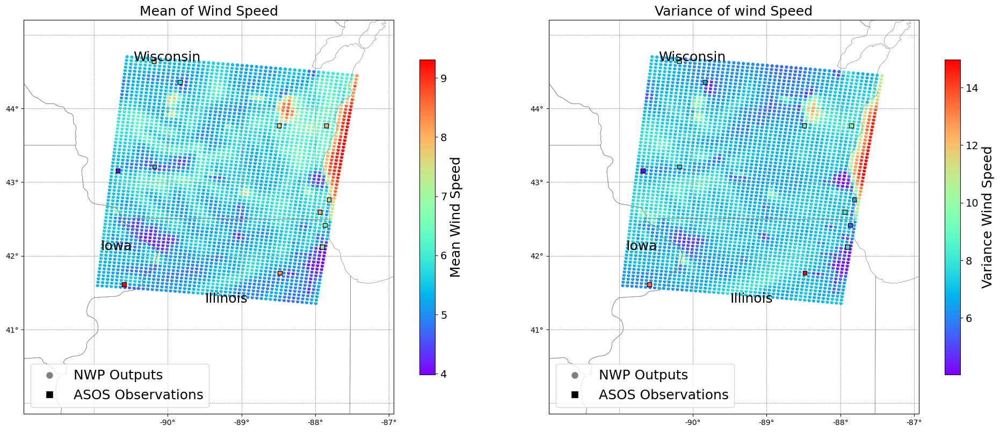

In [14]:
any_in_lat = any(value in nwp_long_fine for value in lon_obs)

sorted_array = np.sort(nwp_lat_fine, axis=None)

lon_min=nwp_long_fine.min()
lon_max=nwp_long_fine.max()
lat_min=nwp_lat_fine.min()
lat_max=nwp_lat_fine.max()

print(f'NWP DATA : {flattened_trimmed_nwp.shape}')
print(f'ASOS data: {flattened_trimmed_obs.shape}')

mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.var(flattened_trimmed_nwp, axis=1)

mean_values_obs = np.mean(flattened_trimmed_obs, axis=0)
variance_values_obs = np.var(flattened_trimmed_obs, axis=0)

# Set up side-by-side plots
fig, ax = plt.subplots(1, 2, figsize=(20, 8), subplot_kw={'projection': ccrs.PlateCarree()})

# Function to add features to both subplots
def add_map_features(ax, title):
    ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=1, edgecolor='black')
    ax.add_feature(cfeature.STATES, edgecolor='gray', linewidth=0.5)

    # Highlight the rectangular grid area
    # ax.plot([lon_min, lon_max, lon_max, lon_min, lon_min],
    #         [lat_min, lat_min, lat_max, lat_max, lat_min],
    #         color='red', linewidth=2, transform=ccrs.PlateCarree(), label='Region of Interest')

    # Add state names
    states_shapefile = natural_earth(resolution='10m', category='cultural', name='admin_1_states_provinces_lakes')
    reader = Reader(states_shapefile)
    for record in reader.records():
        if record.attributes['admin'] == 'United States of America':  # Select U.S. states
            state_name = record.attributes['name']
            lon, lat = record.geometry.centroid.coords[0]
            if lon_min-1 <= lon <= lon_max and lat_min <= lat <= lat_max:
                ax.text(lon, lat, state_name, fontsize=18, ha='center', transform=ccrs.PlateCarree())
            if lon_min-1 <= lon <= lon_max and lat_min <= lat+1.3 <= lat_max:
                ax.text(lon, lat+1.3, state_name, fontsize=18, ha='center', transform=ccrs.PlateCarree())
            if lon_min <= lon+2.8 <= lon_max and lat_min <= lat <= lat_max:
                ax.text(lon+2.8, lat, state_name, fontsize=18, ha='center', transform=ccrs.PlateCarree())
            

    # **Zoom in exactly to the bounding box**
    ax.set_extent([lon_min-1, lon_max+0.5, lat_min-1.5, lat_max+0.5], crs=ccrs.PlateCarree())

    # Customize axes
    ax.set_xticks(range(int(lon_min), int(lon_max) +1), crs=ccrs.PlateCarree())
    ax.set_yticks(range(int(lat_min), int(lat_max) + 1), crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"{x}°"))
    ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: f"{y}°"))
    
    # Gridlines
    ax.gridlines(draw_labels=False, linewidth=0.5, color='gray', linestyle='--')

    # Set title
    ax.set_title(title, fontsize=18)

# Plot Mean Temperature
sc1 = ax[0].scatter(long_flat, lat_flat, c=mean_values, cmap='rainbow', edgecolors='white', s=30, transform=ccrs.PlateCarree())
obs_sc1 = ax[0].scatter(lon_obs, lat_obs, c=mean_values_obs, cmap='rainbow', edgecolors='black', marker='s', s=30, transform=ccrs.PlateCarree())

add_map_features(ax[0], "Mean of Wind Speed")

# Add colorbar
cbar1 = plt.colorbar(sc1, ax=ax[0], orientation='vertical', shrink=0.8)
cbar1.set_label("Mean Wind Speed", fontsize=18)
cbar1.ax.tick_params(labelsize=14)

# Add legend manually
ax[0].legend(handles=[plt.Line2D([0], [0], marker='o', color='w', markersize=10, markerfacecolor='gray', label='NWP Outputs'),
                      plt.Line2D([0], [0], marker='s', color='w', markersize=10, markerfacecolor='black', label='ASOS Observations')],
             loc="lower left", fontsize=18)

# Plot Variance Temperature
sc2 = ax[1].scatter(long_flat, lat_flat, c=variance_values, cmap='rainbow', edgecolors='white', s=30, transform=ccrs.PlateCarree())
obs_sc2 = ax[1].scatter(lon_obs, lat_obs, c=variance_values_obs, cmap='rainbow', edgecolors='black', marker='s', s=30, transform=ccrs.PlateCarree())

add_map_features(ax[1], "Variance of wind Speed")

# Add colorbar
cbar2 = plt.colorbar(sc2, ax=ax[1], orientation='vertical', shrink=0.8)
cbar2.set_label("Variance Wind Speed", fontsize=18)
cbar2.ax.tick_params(labelsize=14)

# Add legend manually
ax[1].legend(handles=[plt.Line2D([0], [0], marker='o', color='w', markersize=10, markerfacecolor='gray', label='NWP Outputs'),
                      plt.Line2D([0], [0], marker='s', color='w', markersize=10, markerfacecolor='black', label='ASOS Observations')],
             loc="lower left", fontsize=18)

# Show plot
plt.tight_layout()
plt.show()


# Path signatures methods

In [17]:
class AddTime(BaseEstimator, TransformerMixin):
    """Add time component to each path.

    For a path of shape [B, L, C] this adds a time channel to be placed at the first index. The time channel will be of
    length L and scaled to exist in [0, 1].
    """
    def fit(self, data, labels=None):
        return self

    def transform(self, data):
        # Batch and length dim
        B, L = data.shape[0], data.shape[1]

        # Time scaled to 0, 1
        time_scaled = torch.linspace(0, 1, L).repeat(B, 1).view(B, L, 1)

        return torch.cat((time_scaled, data), 2)

class AppendZero():
    """ This will append a zero starting vector to every path. """
    def __init__(self):
        pass

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        zero_vec = torch.zeros(size=(X.size(0), 1, X.size(2)))
        return torch.cat((zero_vec, X), dim=1)

_Pair = co.namedtuple('Pair', ('start', 'end'))
def window_getter(string, **kwargs):
    """Gets the window method correspondent to the given string

    Args:
        string (str): String such that string.title() corresponds to a window method.
        *args: Arguments that will be supplied to the window method.

    Returns:
        Window: An initialised Window method.
    """
    return globals()[string](**kwargs)

class Window:
    """Abstract base class for windows.

    Each subclass should implement __call__, which returns a list of list of 2-tuples. Each 2-tuple specifies the start
    and end of a window. These are then grouped together into a list, and these lists are then grouped together again
    into another list. (Really for the sake of the Dyadic window, which considers windows at multiple scales, so the
    different scales of windows should be grouped together but not grouped with each other.)
    """
    def __init__(self):
        if self.__class__ is Window:
            raise NotImplementedError  # abstract base class

    def num_windows(self, length):
        """ Gets the total number of windows produced by the given window method.

        Args:
            length (int): Length of the time series.

        Returns:
            int: Number of windows.
        """
        all_windows = self(length)
        num_windows = 0
        for window_group in all_windows:
            num_windows += len(window_group)
        return num_windows


class Global(Window):
    """A single window over the whole data."""
    def __call__(self, length=None):
        return [[_Pair(None, None)]]


class _ExpandingSliding(Window):
    def __init__(self, initial_length, start_step, end_step):
        super(_ExpandingSliding, self).__init__()
        if self.__class__ is _ExpandingSliding:
            raise NotImplementedError  # abstract base class
        self.initial_length = initial_length
        self.start_step = start_step
        self.end_step = end_step

    def __call__(self, length):
        def _call():
            start = 0
            end = self.initial_length
            while end <= length:
                yield _Pair(start, end)
                start += self.start_step
                end += self.end_step
        return [list(_call())]


class Sliding(_ExpandingSliding):
    """A window starting at zero and going to some point that increases between windows."""
    def __init__(self, length, step):
        super(Sliding, self).__init__(initial_length=length, start_step=step, end_step=step)


class Expanding(_ExpandingSliding):
    """A window of fixed length, slid along the dataset."""
    def __init__(self, length, step):
        super(Expanding, self).__init__(initial_length=length, start_step=0, end_step=step)


class Dyadic(Window):
    """First the global window over the whole thing. Then the window of the first half and the second. Then the window
    over the first quarter, then the second quarter, then the third quarter, then the fourth quarter, etc. down to
    some specified depth. Make sure the depth isn't too high for the length of the dataset, lest we end up with trivial
    windows that we can't compute a signature over.
    """
    def __init__(self, depth):
        super(Dyadic, self).__init__()
        self.depth = depth

    def __call__(self, length):
        return self.call(float(length))

    def call(self, length, _offset=0.0, _depth=0, _out=None):
        if _out is None:
            _out = [[] for _ in range(self.depth + 1)]
        _out[_depth].append(_Pair(int(_offset), int(_offset + length)))

        if _depth < self.depth:
            left = Dyadic(self.depth)
            right = Dyadic(self.depth)
            half_length = length / 2
            # The order of left then right is important, so that they add their entries to _out in the correct order.
            left.call(half_length, _offset, _depth + 1, _out)
            right.call(half_length, _offset + half_length, _depth + 1, _out)

        return _out

def _compute_length(path):
    differences = path[:, 1:] - path[:, :-1]
    # We use the L^\infty norm on reals^d
    out = differences.abs().max(dim=-1).values
    return out.sum(dim=-1)


def _rescale_path(path, depth, by_length=False):
    # Can approximate this pretty well with Stirling's formula if need be... but we don't need to :P
    coeff = math.factorial(depth) ** (1 / depth)

    if by_length:
        length = _compute_length(path)
        coeff = coeff / length
    return coeff * path


def rescale_path(path, depth):
    """Rescales the input path by depth! ** (1 / depth), so that the last signature term should be roughly O(1)."""
    return _rescale_path(path, depth, False)


def rescale_path_by_length(path, depth):
    """Rescales the input path by depth! ** (1 / depth) / Length(path), so that the last signature term should be
    roughly O(1). (In practice this one seems to do a much worse job of rescaling the path then without the length, so
    it's probably not worth using this one.)
    """
    return _rescale_path(path, depth, True)


def _rescale_signature(signature, channels, depth, length, by_length=False):
    sigtensor_channels = signature.size(-1)
    if signatory.signature_channels(channels, depth) != sigtensor_channels:
        raise ValueError("Given a sigtensor with {} channels, a path with {} channels and a depth of {}, which are "
                         "not consistent.".format(sigtensor_channels, channels, depth))

    if by_length:
        length_reciprocal = length.reciprocal()
        for i in range(len(signature.shape) - len(length.shape)):
            length_reciprocal.unsqueeze_(-1)

    end = 0
    term_length = 1
    val = 1
    terms = []
    for d in range(1, depth + 1):
        start = end
        term_length *= channels
        end = start + term_length

        val *= d
        if by_length:
            val *= length_reciprocal

        terms.append(signature[..., start:end] * val)

    return torch.cat(terms, dim=-1)


def rescale_signature(signature, channels, depth):
    """Rescales the output signature by multiplying the depth-d term by d!, so that every term should be about O(1)."""
    return _rescale_signature(signature, channels, depth, None, False)


def rescale_signature_by_length(signature, path, depth):
    """Rescales the output signature by multiplying the depth-d term by d! * Length(path) ** -d, so that every term
    should be about O(1). In practice this seems to do a worse job normalizing things than without the length."""
    return _rescale_signature(signature, path.size(-1), depth, _compute_length(path), True)

def push_batch_trick(x):
    # If given a 4D tensor, will push the first and second dimensions together to 'hide' the second dimension inside the
    # first (batch) dimension.
    if len(x.shape) == 3:
        return _TrickInfo(False, None, None), x
    elif len(x.shape) == 4:
        return _TrickInfo(True, x.size(0), x.size(1)), x.view(x.size(0) * x.size(1), x.size(2), x.size(3))
    else:
        raise RuntimeError("x has {} dimensions, rather than the expected 3 or 4".format(len(x.shape)))


def unpush_batch_trick(trick_info, x):
    # Once a batch-trick'd tensor has been through the signature then it has lost its stream dimension, so all that's
    # left is a (batch * group, signature_channel)-shaped tensor. This now pushes the trick back the other way, so that
    # the group dimensions becomes part of the channel dimension. (Where it really belongs.)
    if len(x.shape) != 2:
        raise RuntimeError("x has {} dimensions, rather than the expected 2.".format(len(x.shape)))
    if trick_info.tricked:
        return x.view(trick_info.batch_size, trick_info.group_size * x.size(1))
    else:
        return x

ADDITIONAL_PARAM_GRIDS = {
    'window': {
        'Sliding': {
            'small': {
                'num_windows': 5,
            },
            'large': {
                'num_windows': 20
            }
        },
        'Expanding': {
            'small': {
                'num_windows': 5,
            },
            'large': {
                'num_windows': 20
            }
        }
    },

    'dyadic_meta': {
        'small': {
            'hidden_channels': 128,
        },
        'large': {
            'hidden_channels': 512
        }
    }
}
def prepare_window(ds_length, window_name, window_kwargs):
    """Window needs special preparation as the parameters can be dependent on dataset length.

    Args:
        ds_length (int): Length of the dataset.
        window_name (str): Name of the window module.
        window_kwargs (dit): Key word arguments from the grid run.

    Returns:
        window module
    """
    # Variable parameters for ('Expanding'/'Sliding') dependent on the size of the dataset
    if window_name in ['Sliding', 'Expanding']:
        num_windows = ADDITIONAL_PARAM_GRIDS['window'][window_name][window_kwargs['size']]['num_windows']
        length = int(np.floor(ds_length / num_windows))
        window_kwargs = {'length': length, 'step': length}

    window = window_getter(window_name, **window_kwargs)

    return window

class ComputeWindowSignature(nn.Module):
    """ Generic class for computing signatures over windows. """
    def __init__(self,
                 window_name=None,
                 window_kwargs=None,
                 ds_length=None,
                 sig_tfm=None,
                 depth=None,
                 rescaling=None,
                 normalisation=None):
        """
        Args:
            window_name (str): The name of the window transformation to use (must be the name of a class in the window
                module)
            window_kwargs (dict): Dictionary of kwargs to pass to the window class.
            sig_tfm (str): The signature transformation to use 'signature' or 'logsignature'.
            depth (int): The depth to compute the signature up to.
            rescaling (str): Scaling before signature computation or after: 'pre' or 'post'.
            normalisation (
        """
        super(ComputeWindowSignature, self).__init__()
        self.ds_length = ds_length
        self.window_name = window_name
        self.window_kwargs = window_kwargs
        self.ds_length = ds_length
        self.sig_tfm = sig_tfm
        self.depth = depth
        self.normalisation = normalisation

        self.window = prepare_window(ds_length, window_name, window_kwargs)

        # Setup rescaling options
        self.pre_rescaling = lambda path, depth: path
        self.post_rescaling = lambda signature, channels, depth: signature
        if rescaling == 'pre':
            self.pre_rescaling = rescaling_module.rescale_path
        elif rescaling == 'post':
            self.post_rescaling = rescaling_module.rescale_signature

    def _check_inputs(self, window):
        assert isinstance(window, window_module.Window)

    def num_windows(self, length):
        """ Gets the window classes num_windows function. """
        return self.window.num_windows(length)

    def forward(self, path, channels=1, trick_info=False):
        # Rescale
        path = self.pre_rescaling(path, self.depth)

        # Prepare for signature computation
        path_obj = signatory.Path(path, self.depth)
        transform = getattr(path_obj, self.sig_tfm)
        length = path_obj.length

        # Compute signatures in each window returning the grouped list structure
        signatures = []
        for window_group in self.window(length):
            signature_group = []
            for window in window_group:
                signature = transform(window.start, window.end)
                rescaled_signature = self.post_rescaling(signature, path.size(2), self.depth)
                untricked_path = rescaled_signature

                if self.normalisation is not None:
                    untricked_path = self.normalisation(untricked_path)

                if trick_info is not False:
                    untricked_path = unpush_batch_trick(trick_info, rescaled_signature)

                signature_group.append(untricked_path)
            signatures.append(signature_group)

        return signatures

def generate_interaction_terms(channels, depth):
    """
    Generate interaction terms (combinations of channels) for a given depth.
    
    Args:
        channels (int): Number of input features (channels).
        depth (int): The depth of the signature.
        
    Returns:
        terms (list): List of interaction terms.
    """
    feature_indices = list(range(0, channels+1))  # Channels are indexed from 1
    interaction_terms = list(itertools.product(feature_indices, repeat=depth))
    return interaction_terms

def map_column_to_interaction(column_index, channels, max_depth=2):
    """
    Map a column index to its corresponding interaction term.
    
    Args:
        column_index (int): Index of the column in the signature.
        channels (int): Number of input channels/features.
        max_depth (int): Maximum depth to consider (default is 2).
    
    Returns:
        depth (int): The depth level of the interaction.
        interaction_term (tuple): The interaction term for the column index.
    """
    # Compute the number of terms at depth 1
    depth_1_terms = channels + 1  # Includes channels + constant term

    # Check if the column belongs to depth 1
    if column_index < depth_1_terms:
        return 1, (column_index,)  # Feature indices start from 1
    
    # Otherwise, map to depth 2 terms
    # Remove depth 1 columns from index
    column_index -= depth_1_terms

    # Generate depth 2 interaction terms
    depth_2_terms = generate_interaction_terms(channels, 2)
    if column_index-depth_1_terms < len(depth_2_terms):
        return 2, depth_2_terms[column_index]
    
    return None, None  # If index out of range


# Evaluate the path signatures

In [20]:
# Create an instance of the AddTime transformer
print(f"Original data shape: {nwp_tensor.shape}")
add_time = AddTime()
append_zero=AppendZero()
transformed_ts = add_time.fit_transform(nwp_tensor)
print(f"After adding time as another channel: {transformed_ts.shape}")
final_transformed_ts= append_zero.transform(transformed_ts)
print(f"Augmenting with 0 in time: {final_transformed_ts.shape}")

Original data shape: torch.Size([46, 15, 3332])
After adding time as another channel: torch.Size([46, 15, 3333])
Augmenting with 0 in time: torch.Size([46, 16, 3333])


In [22]:
# Instantiate the ComputeWindowSignature class
compute_signature = ComputeWindowSignature(
    window_name='Dyadic',          # The windowing method to use
    window_kwargs={'depth': 2},    # Parameters for the windowing method
    ds_length=final_transformed_ts.shape[1] ,                 # Length of the dataset
    sig_tfm='signature',           # Use signature transformation
    depth=1,                       # Signature depth
    rescaling=None,                # Rescaling method
    normalisation=None             # Normalisation method
)

#see the windows in detail
dyadic_window_instance = window_getter('Dyadic', depth=2)
length =final_transformed_ts.shape[1] 
windows = dyadic_window_instance(length)
print(windows)
numwin= compute_signature.num_windows(final_transformed_ts.shape[1])
print(f"Total windows : {numwin}")

# Prepare the input path tensor
path = final_transformed_ts
signatures = compute_signature.forward(path)

# Print the signatures
print(f"Total signatures: len(signatures) ")

flattened_signatures = [signature for group in signatures for signature in group]
print(len(flattened_signatures))
# this is a list of length 7 corresponding to 7 windows,
#each element in the list has signature shape [46,3333]

stacked_signatures = torch.cat(flattened_signatures, dim=1)
print(stacked_signatures.shape)# concatenating all 7 signatures for all windows, first global, then half, then ...

smodule=signatory.signature_module
# Convert PyTorch tensor to NumPy for use with scikit-learn
flattened_signatures = [signature for group in signatures for signature in group]
columnwise_signatures = torch.cat(flattened_signatures, dim=1)
columnwise_signatures_np = columnwise_signatures.detach().cpu().numpy()
print(f'columnwise signatures: {columnwise_signatures_np.shape}')


[[Pair(start=0, end=16)], [Pair(start=0, end=8), Pair(start=8, end=16)], [Pair(start=0, end=4), Pair(start=4, end=8), Pair(start=8, end=12), Pair(start=12, end=16)]]
Total windows : 7
Total signatures: len(signatures) 
7
torch.Size([46, 23331])
columnwise signatures: (46, 23331)


# PCA on path signatures

Stacked signatures in numpy: (46, 23331)
Number of components : 41
PCA Reduced space: (46, 41)


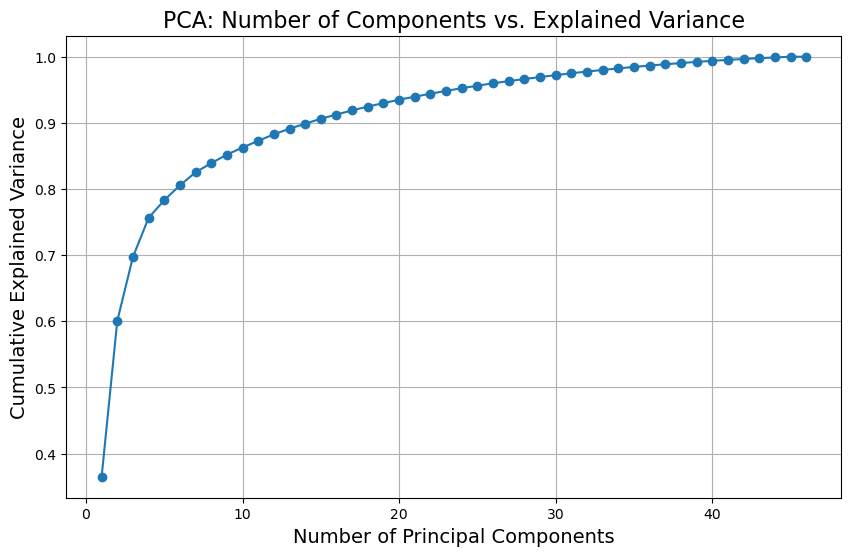

In [25]:
stacked_signatures_np = stacked_signatures.detach().cpu().numpy()
print(f'Stacked signatures in numpy: {stacked_signatures_np.shape}')

scaler = StandardScaler()
signatures_np = scaler.fit_transform(stacked_signatures_np)

# Apply PCA to reduce dimensionality
pca = PCA()
pca.fit(signatures_np)
signatures_pca = pca.transform(signatures_np)
explained_variance = pca.explained_variance_ratio_
cumulative_explained_variance = explained_variance.cumsum()

num_components_95 =  next(i for i, total in enumerate(cumulative_explained_variance) if total > 0.995)+1

print(f"Number of components : {num_components_95}")
reduced_space= signatures_pca[:,:num_components_95]
print(f'PCA Reduced space: {reduced_space.shape}')


# Plot variance explained vs. number of components
plt.figure(figsize=(10, 6))
plt.plot(np.arange(1, len(explained_variance) + 1), cumulative_explained_variance, marker='o', linestyle='-')
plt.xlabel("Number of Principal Components", fontsize=14)
plt.ylabel("Cumulative Explained Variance", fontsize=14)
plt.title("PCA: Number of Components vs. Explained Variance", fontsize=16)
plt.grid()
#plt.savefig('nwp_pca.pdf')
plt.show()


In [27]:
components = pca.components_
unique_interaction_terms = set()

for i, component in enumerate(components):
    most_contributing_feature =np.argmax(np.abs(component))  # Get index of the highest absolute value
    win= most_contributing_feature // signatures[0][0].shape[1]
    col_within_window = most_contributing_feature % signatures[0][0].shape[1]

    depth, interaction_term = map_column_to_interaction(col_within_window, channels=3332, max_depth=2)
    unique_interaction_terms.add(interaction_term)

    print(f"Principal Component {i+1}: Feature {most_contributing_feature} is the most important Depth {depth}, window {win}, Interaction Term: {interaction_term}")

# Print unique interaction terms
print("\nUnique Interaction Terms:")
for term in unique_interaction_terms:
    print(term)


# Use a set to find unique values
unique_values = set()

# Iterate through the list and add values to the set
for term in unique_interaction_terms:
    unique_values.update(term)

# Convert the set back to a sorted list for better readability
unique_values = sorted(unique_values)

# Print the unique values
print("Unique Values:", unique_values)
print(len(unique_values))

Principal Component 1: Feature 5133 is the most important Depth 1, window 1, Interaction Term: (1800,)
Principal Component 2: Feature 1596 is the most important Depth 1, window 0, Interaction Term: (1596,)
Principal Component 3: Feature 14585 is the most important Depth 1, window 4, Interaction Term: (1253,)
Principal Component 4: Feature 21330 is the most important Depth 1, window 6, Interaction Term: (1332,)
Principal Component 5: Feature 13380 is the most important Depth 1, window 4, Interaction Term: (48,)
Principal Component 6: Feature 15534 is the most important Depth 1, window 4, Interaction Term: (2202,)
Principal Component 7: Feature 15984 is the most important Depth 1, window 4, Interaction Term: (2652,)
Principal Component 8: Feature 13634 is the most important Depth 1, window 4, Interaction Term: (302,)
Principal Component 9: Feature 13987 is the most important Depth 1, window 4, Interaction Term: (655,)
Principal Component 10: Feature 20005 is the most important Depth 1, w

(1, 41.59811019897461, -90.95156860351562)
(2, 41.56772232055664, -90.51870727539062)
(3, 41.91356658935547, -87.95968627929688)
(4, 43.12455749511719, -87.8741455078125)
(5, 43.39535903930664, -87.76104736328125)


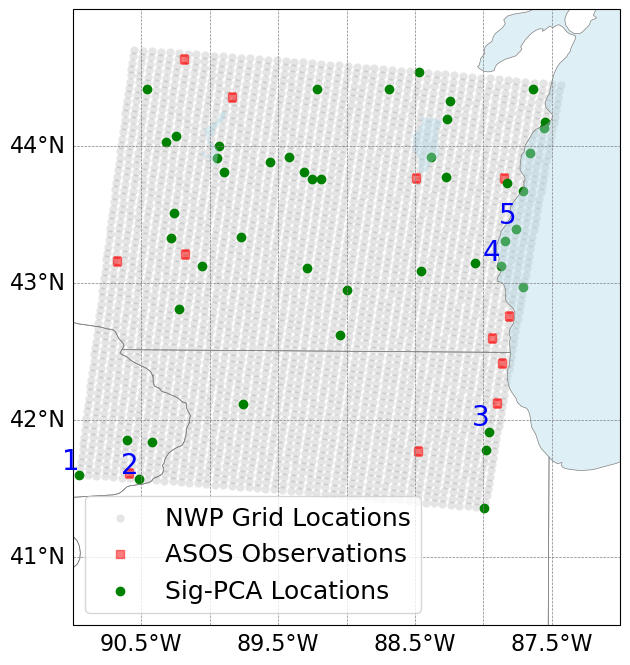

In [31]:
# Create a figure with a map projection
plt.figure(figsize=(12, 8))
ax = plt.axes(projection=ccrs.PlateCarree())

# Scatter plot of all locations first (this will appear on top of the map features)
ax.scatter(long_flat, lat_flat, c='black', marker='o', edgecolor='white', alpha=0.1, label='NWP Grid Locations', transform=ccrs.PlateCarree())
ax.scatter(lon_obs, lat_obs, c='red', marker='s', alpha=0.5, label='ASOS Observations', transform=ccrs.PlateCarree())
ax.scatter(long_flat[unique_values], lat_flat[unique_values], c='green', marker='o', label='Sig-PCA Locations', transform=ccrs.PlateCarree())

# Define the specific indices to label
label_indices = {1, 2, 7,18,22}
selected_points = [(lon, lat) for idx, (lon, lat) in enumerate(zip(long_flat[unique_values], lat_flat[unique_values]), start=1) if idx in label_indices]

# Label only the selected locations with consecutive numbers (1, 2, 3, ...)
for new_idx, (lon, lat) in enumerate(selected_points, start=1):
    print((new_idx, lat,lon))
    ax.text(lon, lat, str(new_idx), fontsize=20, ha='right', va='bottom', color='blue', transform=ccrs.PlateCarree())

# Add natural features for context
ax.add_feature(cfeature.LAND, facecolor='white')
ax.add_feature(cfeature.LAKES, facecolor='lightblue', alpha=0.4)  # Lakes with transparency
ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=1, edgecolor='black')
ax.add_feature(cfeature.STATES, edgecolor='gray', linewidth=0.5)

# Set the extent of the map (bounding box for the region of interest)
ax.set_extent([-91, -87, 40.5, 45], crs=ccrs.PlateCarree())

# Add a grid for better readability
gridlines = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', linestyle='--')
gridlines.top_labels = False
gridlines.right_labels = False

# Increase axis label font size
gridlines.xlabel_style = {'size': 16}  # X-axis label font size
gridlines.ylabel_style = {'size': 16}  # Y-axis label font size
ax.tick_params(axis='both', which='major', labelsize=16)  # Increase tick label font size

# Add title and legend
plt.legend(loc='lower left', fontsize=18)
plt.savefig('nwp_contributions.pdf')

# Show the plot
plt.show()


In [33]:
signature.shape

NameError: name 'signature' is not defined

Processing hierarchical dyadic window depth 1 with 1 sub-windows
Sub-window 1 : Start = 0, End = 16
Processing hierarchical dyadic window depth 2 with 2 sub-windows
Sub-window 1 : Start = 0, End = 8
Sub-window 2 : Start = 8, End = 16
Processing hierarchical dyadic window depth 3 with 4 sub-windows
Sub-window 1 : Start = 0, End = 4
Sub-window 2 : Start = 4, End = 8
Sub-window 3 : Start = 8, End = 12
Sub-window 4 : Start = 12, End = 16


Location 7 fluctuations: [2.3081681728363037, 2.4243457317352295, 2.0509297847747803, 2.466432571411133, 1.3422577381134033, 1.187774896621704, 1.1900811195373535]
Location 48 fluctuations: [2.6031622886657715, 2.7974753379821777, 2.6010866165161133, 2.5832223892211914, 1.4229662418365479, 1.6471596956253052, 1.5685651302337646]
Location 1926 fluctuations: [2.6960690021514893, 2.950105667114258, 2.8083224296569824, 3.0225093364715576, 1.3451541662216187, 1.9211254119873047, 1.32991361618042]
Location 2413 fluctuations: [2.7539005279541016, 2.8298721313476562, 2.3728508949279785, 2.921902656555176, 1.2826107740402222, 1.408897042274475, 1.1598033905029297]
Location 655 fluctuations: [2.5503077507019043, 2.5077662467956543, 2.6385467052459717, 2.696671962738037, 1.3195899724960327, 1.6473934650421143, 1.4861626625061035]


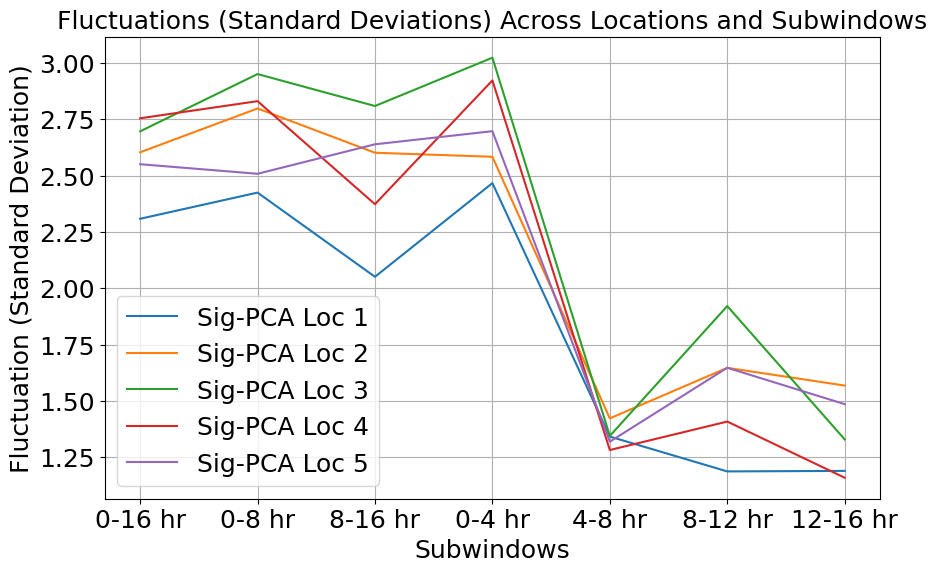

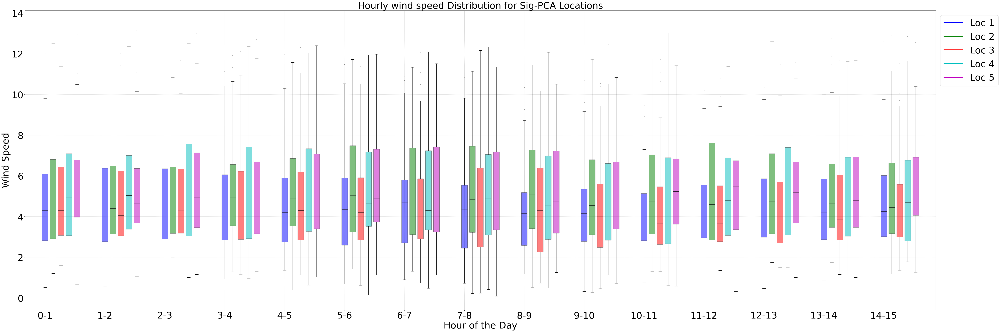

In [43]:
# Initialize an empty list to store the sigpca values
sigpca_values = []

# Loop over each index in label_indices
for i in label_indices:
    # Compute or access the sigpca value for the current index
    sigpca = unique_values[i]  # Assuming unique_values[i] is the value you want
    sigpca_values.append(sigpca)


# Calculate the number of rows and columns for the subplots
depth = 3
num_depths = len(windows[0:depth])  # Number of depth levels
max_sub_windows = max(len(window_list) for window_list in windows[0:depth])  # Maximum number of sub-windows at any depth

# Create a figure with appropriate size
fig, axes = plt.subplots(num_depths, max_sub_windows, figsize=(100, 80), squeeze=False)

# Initialize subplot counter
sub_window_counter = 0

# Store labels for a shared legend
labels = [f'Sig-PCA Loc {i +1}' for i in range(len(label_indices))]  # Assuming at most 10 signature columns
#labels = [f'Sig-PCA Loc {i +1}' for i in range(len(unique_values))]  # Assuming at most 10 signature columns

# Initialize an empty dictionary to store the fluctuations for each location
fluctuations = {}

# Loop over each depth and its sub-windows
for depth_idx, window_list in enumerate(windows[0:depth]):
    print(f"Processing hierarchical dyadic window depth {depth_idx + 1} with {len(window_list)} sub-windows")
    
    for sub_window_idx, pair in enumerate(window_list):
        # Extract the start and end indices of the current sub-window
        start_idx, end_idx = pair.start, pair.end
        print(f"Sub-window {sub_window_idx + 1} : Start = {start_idx}, End = {end_idx}")

        # Extract the corresponding signature for the current window and sub-window (assuming signature is a PyTorch tensor)
        signature = signatures[depth_idx][sub_window_idx]

        # Calculate fluctuations for each location (standard deviation of signature terms)
        for i in sigpca_values:  # Ensure we don't exceed the number of columns in signature
            loc_fluctuation = signature[:, i].std().item()  # Standard deviation as the fluctuation measure
            if i not in fluctuations:
                fluctuations[i] = []
            fluctuations[i].append(loc_fluctuation)

        # for i in unique_values:  # Ensure we don't exceed the number of columns in signature
        #     loc_fluctuation = signature[:, i].std().item()  # Standard deviation as the fluctuation measure
        #     if i not in fluctuations:
        #         fluctuations[i] = []
        #     fluctuations[i].append(loc_fluctuation)


        # Plot the first 100 terms of the signature for this sub-window
        ax = axes[depth_idx, sub_window_idx]  # Get the corresponding subplot
        for i in sigpca_values: 
            # Convert x-axis indices to time in hours, then to days
            num_rows=signature.shape[0]
            x_hours = np.arange(num_rows) * 15  # Each row represents 15 hours
            x_days = x_hours / 24  # Convert hours to days
            
            
            ax.plot(x_days, signature[:, i].numpy())  # Plotting against days
            
            


            #ax.plot(signature[:, i].numpy())  # Convert to NumPy for plotting
        # for i in unique_values:  # Ensure we don't exceed the number of columns in signature
        #     ax.plot(signature[:, i].numpy())  # Convert to NumPy for plotting

    
        # Set title and labels with increased font sizes
        ax.set_xticks(np.arange(0, np.max(x_days) + 1, 5))  # Set major ticks at every 1 day
        ax.set_title(f'Sub-window {sub_window_idx + 1}\nHourly Steps {start_idx}-{end_idx}', fontsize=100)
        ax.set_xlabel('Days', fontsize=100)
        ax.set_ylabel('Signature Value', fontsize=100)

        # Increase tick label font size
        ax.tick_params(axis='both', which='major', labelsize=100)

# Remove empty subplots if there are any
for depth_idx in range(num_depths):
    for sub_window_idx in range(len(windows[depth_idx]), max_sub_windows):
        fig.delaxes(axes[depth_idx, sub_window_idx])

# Add a shared legend for the figure with increased font size
fig.legend(labels, loc='center right', fontsize=100, title="Signature Terms", title_fontsize=100, bbox_to_anchor=(0.9, 0.5))

# Adjust layout to avoid overlapping subplots
plt.tight_layout(rect=[0, 0, 0.9, 1])  # Leave space on the right for the legend

plt.savefig('nwp_signatures_hierarchical.pdf')
plt.show()

# Print the fluctuations for each location
for loc, fluct in fluctuations.items():
    print(f"Location {loc} fluctuations: {fluct}")

# Define the subwindow labels
subwindow_labels = ['0-16 hr', '0-8 hr', '8-16 hr', '0-4 hr', '4-8 hr', '8-12 hr', '12-16 hr']

# Create the plot
plt.figure(figsize=(10, 6))

# Loop through each location's fluctuations and plot
for i, (loc, fluct) in enumerate(fluctuations.items(), start=1):
    plt.plot(range(1, 8), fluct, label=f'Sig-PCA Loc {i}')

# Customize the plot
plt.title("Fluctuations (Standard Deviations) Across Locations and Subwindows", fontsize=18)
plt.xlabel("Subwindows", fontsize=18)
plt.ylabel("Fluctuation (Standard Deviation)", fontsize=18)
plt.xticks(range(1, 8), subwindow_labels, fontsize=18)
plt.yticks(fontsize=18)
plt.legend(loc="lower left", fontsize=18)
plt.grid(True)
plt.savefig('nwpfluctuations.pdf')
plt.show()

# Define hourly time steps (x-axis)
hourly_steps = np.arange(0, 15)  # 15 hourly bins from 0 to 16

# Convert tensor to NumPy for easy handling
data_np = nwp_tensor.numpy()  # Shape: (46, 15, 3332)

# Define distinct colors for each location
colors = ['b', 'g', 'r', 'c', 'm']  # Blue, Green, Red, Cyan, Magenta

# Create a single figure for all box plots
plt.figure(figsize=(60, 20))  # Increase width to fit all box plots comfortably

# Loop through each location and add its box plot
for i, loc in enumerate(sigpca_values):
    if i >= data_np.shape[0]:  # Ensure location index is within bounds
        continue
    
    # Extract wind speed data for the location across all hours
    wind_speeds = data_np[:, :, loc].T  # Shape: (15, 3332) -> hourly wind speed distributions
    
    # Create a box plot for this location with unique color
    # The positions are directly hourly_steps, with slight offset for each location
    plt.boxplot(wind_speeds.T, positions=(hourly_steps*1.5) + (i * 0.2), widths=0.15, patch_artist=True, 
                boxprops=dict(facecolor=colors[i], alpha=0.5), 
                medianprops=dict(color="black"), flierprops=dict(marker='o', markersize=2, alpha=0.5))

# Customize the plot
plt.title("Hourly wind speed Distribution for Sig-PCA Locations", fontsize=40)
plt.xlabel("Hour of the Day", fontsize=40)
plt.ylabel("Wind Speed", fontsize=40)
plt.xticks(hourly_steps*1.5, labels=[f"{h}-{h+1}" for h in hourly_steps], fontsize=40)
plt.yticks(fontsize=40)  # Increase y-axis tick font size
plt.grid(True, linestyle="--", alpha=0.5)

# Manually create legend entries using Line2D to ensure correct color mapping
legend_handles = [Line2D([0], [0], color=color, lw=4) for color in colors]

# Add legend mapping colors to locations and place it outside the plot
# Use labels '1', '2', '3', etc., instead of location numbers
plt.legend(legend_handles, [f"Loc {i+1}" for i in range(len(sigpca_values))], loc="upper left", fontsize=40, bbox_to_anchor=(1, 1), ncol=1)

# Adjust layout and ensure everything fits without overlap
plt.tight_layout()

# Show the plot
plt.savefig('nwp_boxplot.pdf')
plt.show()


# Neural network architecture and custom loss 

In [34]:
def custom_loss(prediction, target, nwpstacktensor, lambda_penalty=10):
    mse_loss = F.mse_loss(prediction, target)

    # Calculate NWP + OUTPUT to check for negative values
    nwp_plus_output = nwpstacktensor + prediction
    
    # Penalize cases where NWP + OUTPUT is negative
    if (nwp_plus_output < 0).any():
        penalty = lambda_penalty * torch.mean((nwp_plus_output[nwp_plus_output < 0]) ** 2)
    else:
        penalty = 0.0
    
    # Return the total loss as the base loss plus any penalty
    return mse_loss + penalty

    
class SimpleNN(nn.Module):
    def __init__(self, input_size, output_size):
        super(SimpleNN, self).__init__()
        
        self.fc1 = nn.Linear(input_size, 128)
        self.bn1 = nn.BatchNorm1d(128)
        
        self.fc2 = nn.Linear(128, 64)
        self.bn2 = nn.BatchNorm1d(64)
        
        self.fc3 = nn.Linear(64, output_size)
        

    def forward(self, x):
        x = torch.relu(self.bn1(self.fc1(x)))
        
        x = torch.relu(self.bn2(self.fc2(x)))
        
        x = self.fc3(x)  # No activation for regression
        return x

class SimpleNNpos(nn.Module):
    def __init__(self, input_size, output_size):
        super(SimpleNNpos, self).__init__()
        
        self.fc1 = nn.Linear(input_size, 128)
        self.bn1 = nn.BatchNorm1d(128)
        
        self.fc2 = nn.Linear(128, 64)
        self.bn2 = nn.BatchNorm1d(64)
        
        self.fc3 = nn.Linear(64, output_size)
        

    def forward(self, x):
        x = torch.relu(self.bn1(self.fc1(x)))
        x = torch.relu(self.bn2(self.fc2(x)))
        
        x = self.fc3(x)  # No activation for regression
        
        return torch.relu(x)  # Ensures non-negative output

# 4% dataset sigpca+DK to output NWP

In [243]:
lon_sigpca_1=long_flat[unique_values]
lat_sigpca_1=lat_flat[unique_values]

In [39]:
# Test input
length=46

num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Romove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)


# Create augmented input
augmented_cols = []

for i in range(len(lat_flat)):
    chunk = reduced_space
    
    # Create an array of shape (length, 2) with lat_obs[i] and lon_obs[i]
    lat_lon_column = np.column_stack((np.full(length, lat_flat[i]), np.full(length, long_flat[i])))
    basiscolumn= np.tile(phigrid[i, :], (length, 1))
    # Concatenate the chunk with the lat/lon columns and the basis functions
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    
    # Append to the list of augmented rows
    augmented_cols.append(augmented_chunk)

# Combine all augmented rows back into one array
testinput = np.vstack(augmented_cols)
testinput_tensor = torch.tensor(testinput, dtype=torch.float32)
print(f"Test input shape nwp grid: {testinput_tensor.shape}")

testtarget_subset = np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
testtarget_tensor = torch.tensor(testtarget_subset, dtype=torch.float32)
print(f"Test output shape nwp grid: {testtarget_tensor.shape}")


Test input shape nwp grid: torch.Size([153272, 1873])
Test output shape nwp grid: torch.Size([153272, 15])


In [41]:
# Training--# Define sample sizes
percent = 4
total_size = 3332
sample_size = round((percent / 100) * total_size)

mse_results = []
length=46
num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

# Randomly select a subset of lat/lon points
np.random.seed(4)
indices = np.random.choice(len(lat_flat), sample_size, replace=False)
lat_subset = lat_flat[indices]
long_subset = long_flat[indices]

llong=np.array(long_subset)
llat= np.array(lat_subset)

normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))

##Wendland kernel
basis_size = 0
phi = np.zeros((len(lat_subset), sum(num_basis)))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phi[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phi[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Romove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phi.shape[1]):
    if sum(phi[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phi_reduce = np.delete(phi,idx_zero,1)

# Prepare input data
augmented_cols = []
for i in range(sample_size):
    lat_lon_column = np.column_stack((np.full(length, lat_subset[i]), np.full(length, long_subset[i])))
    basis_column = np.tile(phi[i, :], (length, 1))
    augmented_chunk = np.hstack((reduced_space, lat_lon_column, basis_column))
    augmented_cols.append(augmented_chunk)

input_subset = np.vstack(augmented_cols)
target_subset = np.vstack([nwp_tensor[:, :, i] for i in indices])

# Convert to PyTorch tensors
inputs_tensor = torch.tensor(input_subset, dtype=torch.float32)
targets_tensor = torch.tensor(target_subset, dtype=torch.float32)
print(f'Input shape: {inputs_tensor.shape}')
print(f'Output NWP at fixed grid shape: {targets_tensor.shape}')

# Train the neural network
model = SimpleNNpos(input_subset.shape[1], target_subset.shape[1])
optimizer = optim.Adam(model.parameters(), lr=0.01)
criterion = nn.MSELoss()

# num_epochs = 5000  # Reduce training iterations for efficiency
# for epoch in range(num_epochs):
#     optimizer.zero_grad()
#     outputs = model(inputs_tensor)
#     loss = criterion(outputs, targets_tensor)
#     loss.backward()
#     optimizer.step()
#     if (epoch + 1) % 100 == 0:
#         print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')
        

# # Evaluate model
# with torch.no_grad():
#     predictions_val = model(testinput_tensor)



Input shape: torch.Size([6118, 1873])
Output NWP at fixed grid shape: torch.Size([6118, 15])
Epoch [100/5000], Loss: 0.5626
Epoch [200/5000], Loss: 0.3275


KeyboardInterrupt: 

In [ ]:
mse = F.mse_loss(predictions_val, testtarget_tensor).item()
print(f"Sample size: {sample_size},  MSE between reconstructed NWP and true NWP entire grid: {mse:.4f}")

nwpgrid=np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
obsstack=np.vstack([obs_tensor[:, :, i] for i in range(obs_tensor.shape[2])])

obstestgrid = np.zeros((flattened_trimmed_nwp.shape[0], flattened_trimmed_nwp.shape[1]))
for i in range(flattened_trimmed_nwp.shape[0]):
    blocknwp = flattened_trimmed_nwp[i, :]
    flattened_series_nwp = blocknwp.flatten()

    blockpredsgrid = predictions_val[i*length:(i+1)*length, :]
    flattened_series_predsgrid = blockpredsgrid.flatten()
    obstestgrid[i, :] = flattened_series_predsgrid
print(obstestgrid.shape)

sigpca_dk_nwp_4percent=obstestgrid

mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.std(flattened_trimmed_nwp, axis=1)

mean_values_obs = np.mean(obstestgrid, axis=1)
variance_values_obs = np.std(obstestgrid, axis=1)

vmin = min(mean_values.min(), mean_values_obs.min())
vmax = max(mean_values.max(), mean_values_obs.max())

vminva = min(variance_values.min(), variance_values_obs.min())
vmaxva = max(variance_values.max(), variance_values_obs.max())


# Plot the mean heatmap using scatter
plt.figure(figsize=(12, 6))  
plt.subplot(1, 2, 1)
sc1=plt.scatter(long_flat, lat_flat, c=mean_values, cmap='rainbow', vmin=vmin, vmax=vmax)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Mean NWP')

plt.subplot(1, 2, 2)
sc2=plt.scatter(long_flat, lat_flat, c=mean_values_obs, cmap='rainbow', vmin=vmin, vmax=vmax)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc2,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Mean Recon NWP')

plt.tight_layout()
plt.show()


plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sc3=plt.scatter(long_flat, lat_flat, c=variance_values, cmap='rainbow',vmin=vminva, vmax=vmaxva)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc3,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Standard deviation NWP')

plt.subplot(1, 2, 2)
sc4=plt.scatter(long_flat, lat_flat, c=variance_values_obs, cmap='rainbow',vmin=vminva, vmax=vmaxva)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc4,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Standard deviation Recon NWP')
plt.tight_layout()
plt.show()


# Require/Train only on 4% of NWP GRID and output ASOS Grid with Sig-PCA+DK and NWP Correction

In [43]:
closest_lats = []
closest_lons = []
closest_indices = []
for latc, lonc in zip(lat_obs, lon_obs):
    # Calculate the distance to each station in lat_flat and long_flat
    distances = np.sqrt((lat_flat - latc)**2 + (long_flat - lonc)**2)
    closest_index = np.argmin(distances)  # Find the index of the minimum distance
    
    # Append the closest latitude, longitude, and index
    closest_lats.append(lat_flat [closest_index])
    closest_lons.append(long_flat[closest_index])
    closest_indices.append(closest_index)

# Convert to numpy arrays for easy handling
closest_lats = np.array(closest_lats)
closest_lons = np.array(closest_lons)
closest_indices = np.array(closest_indices)
print(len(closest_indices))

12


In [47]:
# Test input
length=46

num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Romove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)


# Create augmented input
augmented_cols = []

for i in range(len(lat_flat)):
    chunk = reduced_space
    
    # Create an array of shape (length, 2) with lat_obs[i] and lon_obs[i]
    lat_lon_column = np.column_stack((np.full(length, lat_flat[i]), np.full(length, long_flat[i])))
    basiscolumn= np.tile(phigrid[i, :], (length, 1))
    # Concatenate the chunk with the lat/lon columns and the basis functions
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    
    # Append to the list of augmented rows
    augmented_cols.append(augmented_chunk)

# Combine all augmented rows back into one array
testinput = np.vstack(augmented_cols)
testinput_tensor = torch.tensor(testinput, dtype=torch.float32)
print(f"Test input shape nwp grid: {testinput_tensor.shape}")

testtarget_subset = np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
testtarget_tensor = torch.tensor(testtarget_subset, dtype=torch.float32)
print(f"Test output shape nwp grid: {testtarget_tensor.shape}")


Test input shape nwp grid: torch.Size([153272, 1873])
Test output shape nwp grid: torch.Size([153272, 15])


In [101]:
num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

llong=np.array(lon_obs)
llat= np.array(lat_obs)

normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))

##Wendland kernel
basis_size = 0
phi = np.zeros((len(lat_obs), sum(num_basis)))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phi[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phi[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

idx_zero = np.array([], dtype=int)
for i in range(phi.shape[1]):
    if sum(phi[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phi_reduce = np.delete(phi,idx_zero,1)


num_basis = [10**2,19**2,37**2]

phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)

length=nwp_tensor.shape[0]
augmented_cols = []
for i in range(len(lat_obs)):
    chunk = reduced_space
    lat_lon_column = np.column_stack((np.full(length, lat_obs[i]), np.full(length, lon_obs[i])))
    basiscolumn= np.tile(phi[i, :], (length, 1))
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    augmented_cols.append(augmented_chunk)

input = np.vstack(augmented_cols)
print(f'Training on OBS lat long and sig PCA: {input.shape}')

recon_nwp_3332=np.zeros(nwp_tensor.shape)
for i in range(nwp_tensor.shape[2]):
    recon_nwp_3332[:, :, i] = torch.from_numpy(sigpca_dk_nwp_4percent[i, :].reshape(nwp_tensor.shape[0],nwp_tensor.shape[1])).float()
print(f'Shape of reconstructed NWP : {recon_nwp_3332.shape}')

recon_nwp_3332_closestin=np.vstack([recon_nwp_3332[:, :, i] for i in closest_indices])
print(f'Shape of reconstructed NWP at obs locations: {recon_nwp_3332_closestin.shape}')

# output is OBS-reconstructed NWP[ closest indices]
output= obsstack-recon_nwp_3332_closestin
print(f'Correction output: {output.shape}')

input_size = input.shape[1]
output_size = output.shape[1]


nwpobsgrid=nwp_tensor[:,:,closest_indices]
print(f'nwpobsgrid shape: {nwpobsgrid.shape}')
nwpstack=np.vstack([nwpobsgrid[:, :, i] for i in range(nwpobsgrid.shape[2])])
print(f"NWP stacked shape: {nwpstack.shape}") 
nwpstacktensor= torch.tensor(nwpstack, dtype=torch.float32)
print(f"NWP stacked tensor shape: {nwpstacktensor.shape}") 


model = SimpleNN(input_size,output_size)

optimizer = optim.Adam(model.parameters(), lr=0.01) #0.01 is good

inputs_tensor=torch.tensor(input, dtype=torch.float32)
print(f"Input shape: {inputs_tensor.shape}")
targets_tensor=torch.tensor(output, dtype=torch.float32)
print(f"Output shape : {targets_tensor.shape}")

num_epochs = 5000

for epoch in range(num_epochs):
    optimizer.zero_grad()  
    outputs = model(inputs_tensor) 
    loss = custom_loss(outputs, targets_tensor,nwpstacktensor)
    loss.backward()  
    optimizer.step()  
    if (epoch + 1) % 100 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')
        

with torch.no_grad(): 
    predictions = model(testinput_tensor) 

targets_np = targets_tensor.cpu().numpy() 
predictions_np = predictions.cpu().numpy() 


obstestgrid_recon = np.zeros((flattened_trimmed_nwp.shape[0], flattened_trimmed_nwp.shape[1]))

for i in range(flattened_trimmed_nwp.shape[0]):
    blocknwp = sigpca_dk_nwp_4percent[i, :]
    flattened_series_nwp_recon = blocknwp.flatten()

    blockpredsgrid = predictions_np[i*length:(i+1)*length, :]
    flattened_series_predsgrid = blockpredsgrid.flatten()

    obstestgrid_recon[i, :] = flattened_series_nwp_recon + flattened_series_predsgrid

print(obstestgrid_recon.shape)

sigpca_dk_grid_corr_4percent=obstestgrid_recon


Training on OBS lat long and sig PCA: (552, 1873)
Shape of reconstructed NWP : (46, 15, 3332)
Shape of reconstructed NWP at obs locations: (552, 15)
Correction output: (552, 15)
nwpobsgrid shape: torch.Size([46, 15, 12])
NWP stacked shape: (552, 15)
NWP stacked tensor shape: torch.Size([552, 15])
Input shape: torch.Size([552, 1873])
Output shape : torch.Size([552, 15])
Epoch [100/5000], Loss: 2.1284
Epoch [200/5000], Loss: 1.8394
Epoch [300/5000], Loss: 1.4084
Epoch [400/5000], Loss: 1.7411
Epoch [500/5000], Loss: 1.0824
Epoch [600/5000], Loss: 1.0731
Epoch [700/5000], Loss: 1.0634
Epoch [800/5000], Loss: 1.3771
Epoch [900/5000], Loss: 0.8339
Epoch [1000/5000], Loss: 0.6351
Epoch [1100/5000], Loss: 0.5270
Epoch [1200/5000], Loss: 1.1589
Epoch [1300/5000], Loss: 1.1510
Epoch [1400/5000], Loss: 0.6739
Epoch [1500/5000], Loss: 0.8561
Epoch [1600/5000], Loss: 0.9682
Epoch [1700/5000], Loss: 0.6607
Epoch [1800/5000], Loss: 0.5840
Epoch [1900/5000], Loss: 0.6920
Epoch [2000/5000], Loss: 0.75

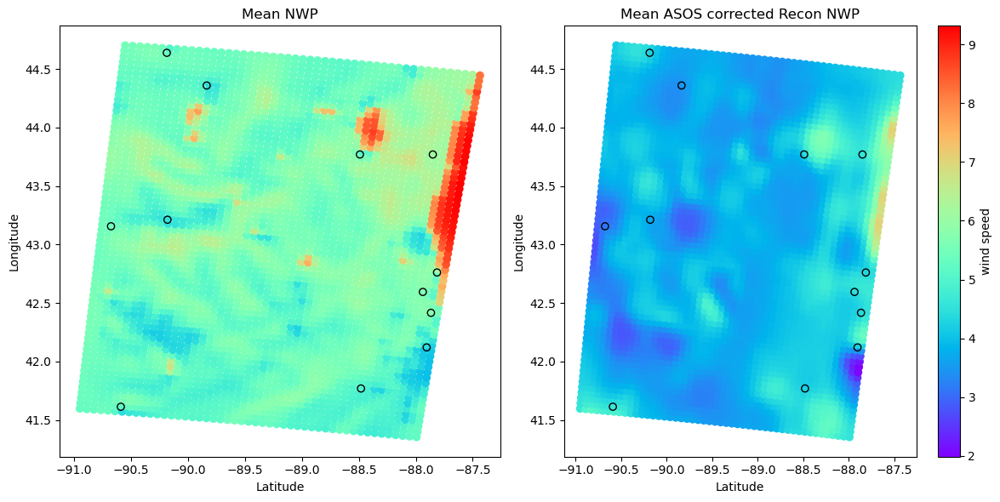

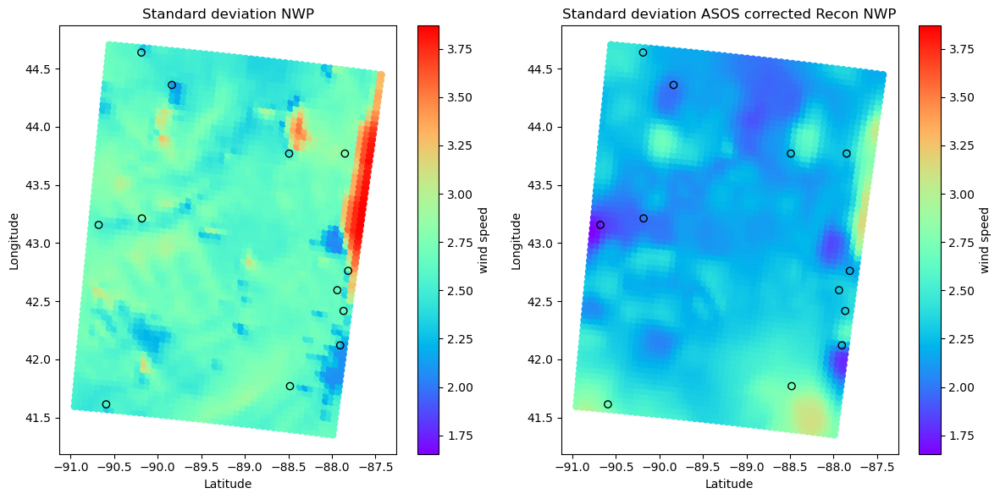

In [103]:
mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.std(flattened_trimmed_nwp, axis=1)

mean_values_obs = np.mean(obstestgrid_recon, axis=1)
variance_values_obs = np.std(obstestgrid_recon, axis=1)

vmin = min(mean_values.min(), mean_values_obs.min())
vmax = max(mean_values.max(), mean_values_obs.max())

vminva = min(variance_values.min(), variance_values_obs.min())
vmaxva = max(variance_values.max(), variance_values_obs.max())


# Plot the mean heatmap using scatter
plt.figure(figsize=(12, 6))  
plt.subplot(1, 2, 1)
sc1=plt.scatter(long_flat, lat_flat, c=mean_values, cmap='rainbow', vmin=vmin, vmax=vmax)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Mean NWP')

plt.subplot(1, 2, 2)
sc2=plt.scatter(long_flat, lat_flat, c=mean_values_obs, cmap='rainbow', vmin=vmin, vmax=vmax)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc2,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Mean ASOS corrected Recon NWP')

plt.tight_layout()
plt.show()


plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sc3=plt.scatter(long_flat, lat_flat, c=variance_values, cmap='rainbow',vmin=vminva, vmax=vmaxva)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc3,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Standard deviation NWP')

plt.subplot(1, 2, 2)
sc4=plt.scatter(long_flat, lat_flat, c=variance_values_obs, cmap='rainbow',vmin=vminva, vmax=vmaxva)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc4,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Standard deviation ASOS corrected Recon NWP')
plt.tight_layout()
plt.show()


# Save and load outputs

In [45]:
# np.save("sigpca_dk_nwp_4percent.npy", sigpca_dk_nwp_4percent)
# np.save("sigpca_dk_grid_corr_4percent.npy", sigpca_dk_grid_corr_4percent)

sigpca_dk_nwp_4percent= np.load(  "sigpca_dk_nwp_4percent.npy")
sigpca_dk_grid_corr_4percent = np.load("sigpca_dk_grid_corr_4percent.npy")

In [113]:
np.mean(np.sqrt(np.mean(np.square(sigpca_dk_nwp_4percent-flattened_trimmed_nwp),axis=1))/ np.mean(flattened_trimmed_nwp,axis=1)*100)

13.63458797111837

# Require/Train only on 4% of NWP GRID and output whole NWP Grid with EOF+DK

/var/folders/b5/7ttzcvrn2mngkw42xq19k9m1cmzbbx/T/ipykernel_63589/1899397349.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  nwpsvdtensor= torch.tensor(reshaped_data, dtype=torch.float32)


torch.Size([46, 49980])


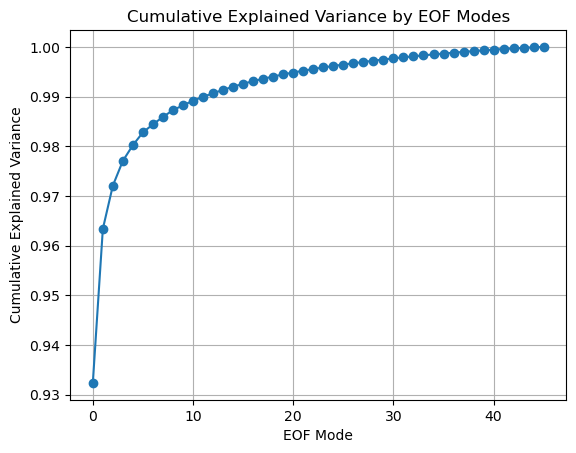

Number of components explaining 99% variance: 22


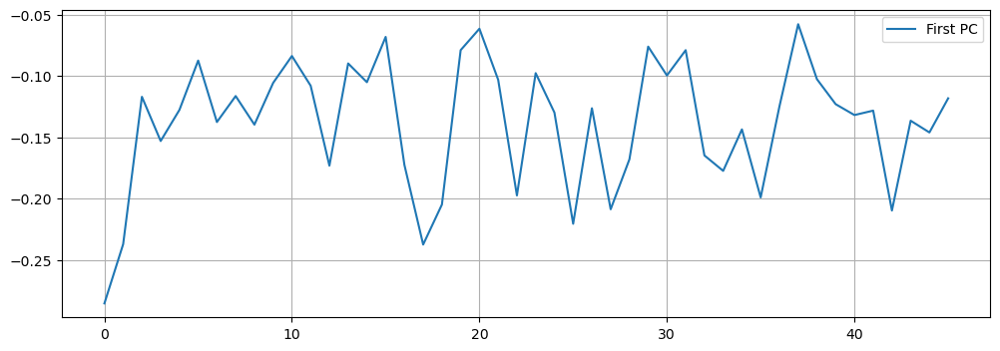

In [55]:
data = nwp_tensor 
# Reshape to (timesteps, features*locations)
num_timesteps, num_features, num_locs = data.shape
reshaped_data = data.reshape(num_timesteps, num_features * num_locs)  # Shape: (320, 24*5120)

nwpsvdtensor= torch.tensor(reshaped_data, dtype=torch.float32)

print(nwpsvdtensor.shape)
U, S, V = torch.svd(nwpsvdtensor)

#Calculate explained variance
# Square the singular values to get the variance explained by each mode
singular_values_squared = S**2

# Calculate total variance
total_variance = torch.sum(singular_values_squared)

# Calculate explained variance for each mode
explained_variance = singular_values_squared / total_variance
# Calculate cumulative variance explained by the first k modes
cumulative_variance = torch.cumsum(explained_variance,dim=0)

# Step 5: Plot the cumulative explained variance
plt.figure()
plt.plot(cumulative_variance.numpy(), marker='o')
plt.title('Cumulative Explained Variance by EOF Modes')
plt.xlabel('EOF Mode')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.savefig('nwp_eofmodes.pdf')
plt.show()

num_components_95 = next(i for i, total in enumerate(cumulative_variance) if total > 0.995)+1

print(f"Number of components explaining 99% variance: {num_components_95}")


# Select the number of EOF modes (latent space size)
#  keep the first k EOF modes
k = num_components_95
V_k = V[:k, :]  # Use the first k columns of V (right singular vectors)
U_reduced = U[:, :k]  
S_reduced = S[:k]     
V_reduced = V[:, :k]   


plt.figure(figsize=(12,4))
plt.plot(U_reduced[:,0], label="First PC")
plt.grid()
plt.legend()
plt.show()
# plt.figure(figsize=(12,4))
# plt.plot(U_reduced[:,1], label="Second PC")
# plt.grid()
# plt.legend()
# plt.show()

In [57]:
reduced_data = U_reduced #@ torch.diag(S_reduced) @ V_reduced.T
print(f"EOF  space dimension {reduced_data.shape}")

EOF  space dimension torch.Size([46, 22])


Test input nwp grid: torch.Size([153272, 1854])
Test output shape nwp grid: torch.Size([153272, 15])
Input shape: torch.Size([6118, 1854])
Output shape: torch.Size([6118, 15])
Epoch [100/5000], Loss: 0.6036
Epoch [200/5000], Loss: 0.3508
Epoch [300/5000], Loss: 0.2868
Epoch [400/5000], Loss: 0.2407
Epoch [500/5000], Loss: 0.2735
Epoch [600/5000], Loss: 0.2233
Epoch [700/5000], Loss: 0.1819
Epoch [800/5000], Loss: 0.1638
Epoch [900/5000], Loss: 0.1552
Epoch [1000/5000], Loss: 0.1617
Epoch [1100/5000], Loss: 0.1385
Epoch [1200/5000], Loss: 0.1312
Epoch [1300/5000], Loss: 0.1504
Epoch [1400/5000], Loss: 0.1387
Epoch [1500/5000], Loss: 0.1244
Epoch [1600/5000], Loss: 0.1152
Epoch [1700/5000], Loss: 0.1140
Epoch [1800/5000], Loss: 0.1097
Epoch [1900/5000], Loss: 0.1252
Epoch [2000/5000], Loss: 0.1124
Epoch [2100/5000], Loss: 0.1047
Epoch [2200/5000], Loss: 0.1125
Epoch [2300/5000], Loss: 0.1042
Epoch [2400/5000], Loss: 0.1006
Epoch [2500/5000], Loss: 0.0987
Epoch [2600/5000], Loss: 0.1117
E

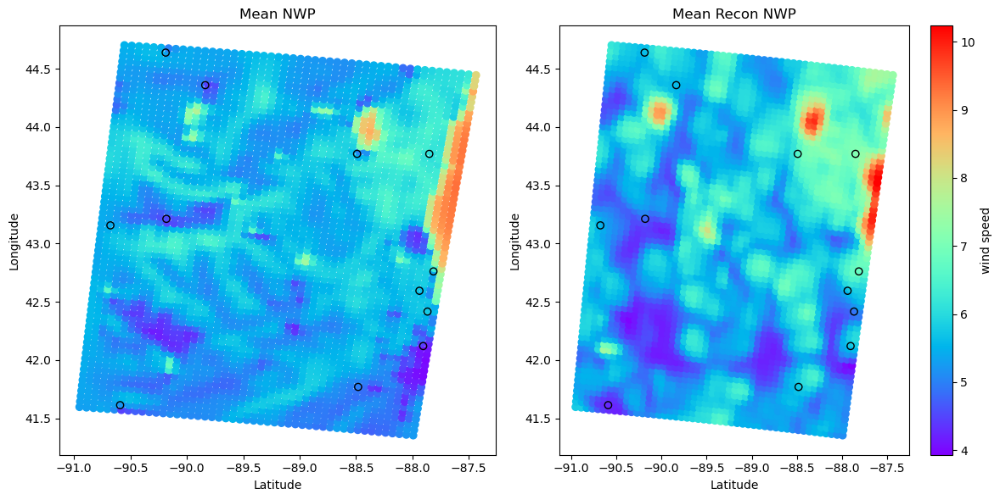

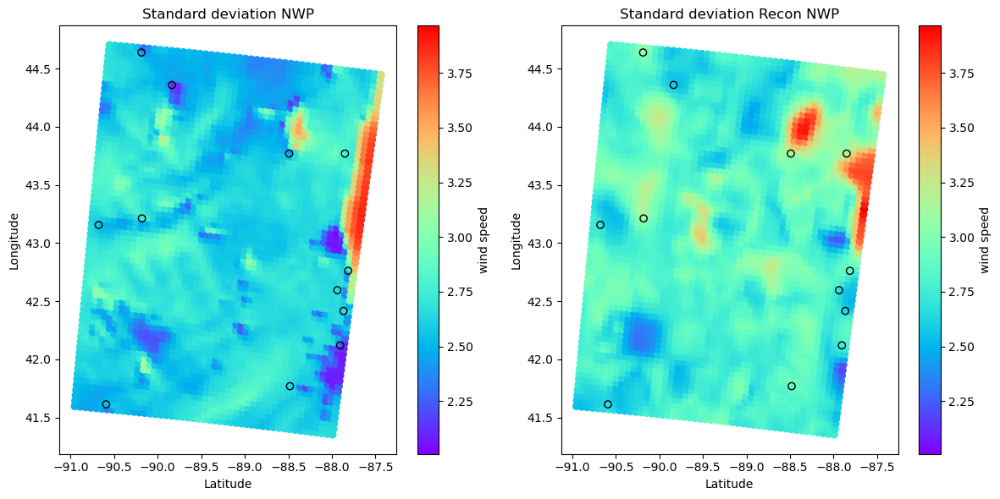

In [61]:
# TESTING INPUT
num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

length= reduced_data.shape[0]
phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Remove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)

augmented_cols = []

for i in range(len(lat_flat)):
    chunk = reduced_data
    lat_lon_column = np.column_stack((np.full(length, lat_flat[i]), np.full(length, long_flat[i])))
    basiscolumn= np.tile(phigrid[i, :], (length, 1))
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    augmented_cols.append(augmented_chunk)

testinput = np.vstack(augmented_cols)
testinput_tensor = torch.tensor(testinput, dtype=torch.float32)
print(f"Test input nwp grid: {testinput_tensor.shape}")

#
testtarget = np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
testtarget_tensor = torch.tensor(testtarget, dtype=torch.float32)
print(f"Test output shape nwp grid: {testtarget_tensor.shape}")
percent = 4
total_size = 3332
sample_size = round((percent / 100) * total_size)

length= nwp_tensor.shape[0]
num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

np.random.seed(42)
indices = np.random.choice(len(lat_flat), sample_size, replace=False)
lat_subset = lat_flat[indices]
long_subset = long_flat[indices]


llong=np.array(long_subset)
llat= np.array(lat_subset)

normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))

##Wendland kernel
basis_size = 0
phi = np.zeros((len(lat_subset), sum(num_basis)))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phi[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phi[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Romove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phi.shape[1]):
    if sum(phi[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phi_reduce = np.delete(phi,idx_zero,1)

# Prepare input data
augmented_cols = []
for i in range(sample_size):
    lat_lon_column = np.column_stack((np.full(length, lat_subset[i]), np.full(length, long_subset[i])))
    basis_column = np.tile(phi[i, :], (length, 1))
    augmented_chunk = np.hstack((reduced_data, lat_lon_column, basis_column))
    augmented_cols.append(augmented_chunk)

input_subset = np.vstack(augmented_cols)
target_subset = np.vstack([nwp_tensor[:, :, i] for i in indices])

# Convert to PyTorch tensors
inputs_tensor = torch.tensor(input_subset, dtype=torch.float32)
targets_tensor = torch.tensor(target_subset, dtype=torch.float32)
print(f'Input shape: {inputs_tensor.shape}')
print(f'Output shape: {targets_tensor.shape}')

nwpobsgrid=nwp_tensor[:,:,closest_indices]
print(f'nwpobsgrid shape: {nwpobsgrid.shape}')
nwpstack=np.vstack([nwpobsgrid[:, :, i] for i in range(nwpobsgrid.shape[2])])
print(f"NWP stacked shape: {nwpstack.shape}") 
nwpstacktensor= torch.tensor(nwpstack, dtype=torch.float32)
print(f"NWP stacked tensor shape: {nwpstacktensor.shape}") 

model = SimpleNNpos(input_subset.shape[1], target_subset.shape[1])
optimizer = optim.Adam(model.parameters(), lr=0.01)
criterion = nn.MSELoss()


# Train the neural network
model = SimpleNN(input_subset.shape[1], target_subset.shape[1])
optimizer = optim.Adam(model.parameters(), lr=0.01)
num_epochs = 5000  # Reduce training iterations for efficiency
for epoch in range(num_epochs):
    optimizer.zero_grad()
    outputs = model(inputs_tensor)
    loss = criterion(outputs, targets_tensor)
    loss.backward()
    optimizer.step()
    # Print loss every 10 epochs
    if (epoch + 1) % 100 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# Evaluate model
with torch.no_grad():
    predictions = model(testinput_tensor)

mse = F.mse_loss(predictions, testtarget_tensor).item()
print(f"Sample size: {sample_size},  MSE between reconstructed NWP and true NWP entire grid: {mse:.4f}")

nwpgrid=np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
obsstack=np.vstack([obs_tensor[:, :, i] for i in range(obs_tensor.shape[2])])

obstestgrid = np.zeros((flattened_trimmed_nwp.shape[0], flattened_trimmed_nwp.shape[1]))
for i in range(flattened_trimmed_nwp.shape[0]):
    blocknwp = flattened_trimmed_nwp[i, :]
    flattened_series_nwp = blocknwp.flatten()

    blockpredsgrid = predictions[i*length:(i+1)*length, :]
    flattened_series_predsgrid = blockpredsgrid.flatten()
    obstestgrid[i, :] = flattened_series_predsgrid
print(obstestgrid.shape)

eof_dk_nwp_4percent=obstestgrid

mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.std(flattened_trimmed_nwp, axis=1)

mean_values_obs = np.mean(obstestgrid, axis=1)
variance_values_obs = np.std(obstestgrid, axis=1)

vmin = min(mean_values.min(), mean_values_obs.min())
vmax = max(mean_values.max(), mean_values_obs.max())

vminva = min(variance_values.min(), variance_values_obs.min())
vmaxva = max(variance_values.max(), variance_values_obs.max())


# Plot the mean heatmap using scatter
plt.figure(figsize=(12, 6))  
plt.subplot(1, 2, 1)
sc1=plt.scatter(long_flat, lat_flat, c=mean_values, cmap='rainbow', vmin=vmin, vmax=vmax)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Mean NWP')

plt.subplot(1, 2, 2)
sc2=plt.scatter(long_flat, lat_flat, c=mean_values_obs, cmap='rainbow', vmin=vmin, vmax=vmax)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc2,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Mean Recon NWP')

plt.tight_layout()
plt.show()


plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sc3=plt.scatter(long_flat, lat_flat, c=variance_values, cmap='rainbow',vmin=vminva, vmax=vmaxva)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc3,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Standard deviation NWP')

plt.subplot(1, 2, 2)
sc4=plt.scatter(long_flat, lat_flat, c=variance_values_obs, cmap='rainbow',vmin=vminva, vmax=vmaxva)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc4,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Standard deviation Recon NWP')
plt.tight_layout()
plt.show()


# Require/Train only on 4% of NWP GRID and output ASOS Grid with EOF+DK and NWP Correction

In [67]:
closest_lats = []
closest_lons = []
closest_indices = []
for latc, lonc in zip(lat_obs, lon_obs):
    # Calculate the distance to each station in lat_flat and long_flat
    distances = np.sqrt((lat_flat - latc)**2 + (long_flat - lonc)**2)
    closest_index = np.argmin(distances)  # Find the index of the minimum distance
    
    # Append the closest latitude, longitude, and index
    closest_lats.append(lat_flat [closest_index])
    closest_lons.append(long_flat[closest_index])
    closest_indices.append(closest_index)

# Convert to numpy arrays for easy handling
closest_lats = np.array(closest_lats)
closest_lons = np.array(closest_lons)
closest_indices = np.array(closest_indices)
print(len(closest_indices))

12


In [69]:
num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

llong=np.array(lon_obs)
llat= np.array(lat_obs)

normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))

##Wendland kernel
basis_size = 0
phi = np.zeros((len(lat_obs), sum(num_basis)))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phi[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phi[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

idx_zero = np.array([], dtype=int)
for i in range(phi.shape[1]):
    if sum(phi[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phi_reduce = np.delete(phi,idx_zero,1)


num_basis = [10**2,19**2,37**2]

phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)

length=nwp_tensor.shape[0]
augmented_cols = []
for i in range(len(lat_obs)):
    chunk = reduced_data
    lat_lon_column = np.column_stack((np.full(length, lat_obs[i]), np.full(length, lon_obs[i])))
    basiscolumn= np.tile(phi[i, :], (length, 1))
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    augmented_cols.append(augmented_chunk)

input = np.vstack(augmented_cols)
print(f'Training on OBS lat long and sig PCA: {input.shape}')

recon_nwp_3332=np.zeros(nwp_tensor.shape)
for i in range(nwp_tensor.shape[2]):
    recon_nwp_3332[:, :, i] = torch.from_numpy(eof_dk_nwp_4percent[i, :].reshape(nwp_tensor.shape[0],nwp_tensor.shape[1])).float()
print(f'Shape of reconstructed NWP : {recon_nwp_3332.shape}')

recon_nwp_3332_closestin=np.vstack([recon_nwp_3332[:, :, i] for i in closest_indices])
print(f'Shape of reconstructed NWP at obs locations : {recon_nwp_3332_closestin.shape}')

# output is OBS-reconstructed NLDAS[ closest indices]
output= obsstack-recon_nwp_3332_closestin
print(f'Correction output: {output.shape}')

nwpobsgrid=nwp_tensor[:,:,closest_indices]
print(f'nwpobsgrid shape: {nwpobsgrid.shape}')
nwpstack=np.vstack([nwpobsgrid[:, :, i] for i in range(nwpobsgrid.shape[2])])
print(f"NWP stacked shape: {nwpstack.shape}") 
nwpstacktensor= torch.tensor(nwpstack, dtype=torch.float32)
print(f"NWP stacked tensor shape: {nwpstacktensor.shape}") 


input_size = input.shape[1]
output_size = output.shape[1]

model = SimpleNN(input_size,output_size)
optimizer = optim.Adam(model.parameters(), lr=0.01) #0.01 is good

inputs_tensor=torch.tensor(input, dtype=torch.float32)
print(f"Input shape: {inputs_tensor.shape}")
targets_tensor=torch.tensor(output, dtype=torch.float32)
print(f"Output shape : {targets_tensor.shape}")

num_epochs = 5000

for epoch in range(num_epochs):
    optimizer.zero_grad()  
    outputs = model(inputs_tensor) 
    loss = custom_loss(outputs, targets_tensor,nwpstacktensor)
    loss.backward()  
    optimizer.step()  
    if (epoch + 1) % 100 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')
        

with torch.no_grad(): 
    predictions = model(testinput_tensor) 

targets_np = targets_tensor.cpu().numpy() 
predictions_np = predictions.cpu().numpy() 


obstestgrid_recon = np.zeros((flattened_trimmed_nwp.shape[0], flattened_trimmed_nwp.shape[1]))

for i in range(flattened_trimmed_nwp.shape[0]):
    blocknwp = eof_dk_nwp_4percent[i, :]
    flattened_series_nwp_recon = blocknwp.flatten()

    blockpredsgrid = predictions_np[i*length:(i+1)*length, :]
    flattened_series_predsgrid = blockpredsgrid.flatten()

    obstestgrid_recon[i, :] = flattened_series_nwp_recon + flattened_series_predsgrid

print(obstestgrid_recon.shape)

eof_dk_grid_corr_4percent=obstestgrid_recon


Training on OBS lat long and sig PCA: (552, 1854)
Shape of reconstructed NWP : (46, 15, 3332)
Shape of reconstructed NWP at obs locations : (552, 15)
Correction output: (552, 15)
nwpobsgrid shape: torch.Size([46, 15, 12])
NWP stacked shape: (552, 15)
NWP stacked tensor shape: torch.Size([552, 15])
Input shape: torch.Size([552, 1854])
Output shape : torch.Size([552, 15])
Epoch [100/5000], Loss: 2.3321
Epoch [200/5000], Loss: 1.7003
Epoch [300/5000], Loss: 1.4848
Epoch [400/5000], Loss: 1.6152
Epoch [500/5000], Loss: 1.5768
Epoch [600/5000], Loss: 1.4848
Epoch [700/5000], Loss: 1.1336
Epoch [800/5000], Loss: 1.0864
Epoch [900/5000], Loss: 1.2322
Epoch [1000/5000], Loss: 1.1030
Epoch [1100/5000], Loss: 0.9451
Epoch [1200/5000], Loss: 1.4158
Epoch [1300/5000], Loss: 0.9934
Epoch [1400/5000], Loss: 0.7319
Epoch [1500/5000], Loss: 0.7722
Epoch [1600/5000], Loss: 0.8636
Epoch [1700/5000], Loss: 0.7762
Epoch [1800/5000], Loss: 0.8218
Epoch [1900/5000], Loss: 1.4389
Epoch [2000/5000], Loss: 1.0

# save and load outputs

In [47]:
# np.save("eof_dk_nwp_4percent.npy", eof_dk_nwp_4percent)
# np.save("eof_dk_grid_corr_4percent.npy", eof_dk_grid_corr_4percent)

eof_dk_nwp_4percent= np.load("eof_dk_nwp_4percent.npy")
eof_dk_grid_corr_4percent = np.load("eof_dk_grid_corr_4percent.npy")

# Depth 2 on selected locations

In [50]:
# Create an instance of the AddTime transformer
print(f"Original data shape of selected locations: {nwp_tensor[:,:, unique_values].shape}")
add_time = AddTime()
append_zero=AppendZero()
transformed_ts = add_time.fit_transform(nwp_tensor[:,:, unique_values])
print(f"After adding time as another channel: {transformed_ts.shape}")
final_transformed_ts= append_zero.transform(transformed_ts)
print(f"Augmenting with 0 in time: {final_transformed_ts.shape}")



Original data shape of selected locations: torch.Size([46, 15, 46])
After adding time as another channel: torch.Size([46, 15, 47])
Augmenting with 0 in time: torch.Size([46, 16, 47])


[[Pair(start=0, end=16)], [Pair(start=0, end=8), Pair(start=8, end=16)], [Pair(start=0, end=4), Pair(start=4, end=8), Pair(start=8, end=12), Pair(start=12, end=16)]]
Total windows : 7
Total signatures: len(signatures) 
7
torch.Size([46, 15792])
columnwise signatures: (46, 15792)
Stacked signatures in numpy: (46, 15792)
Number of components : 43
PCA Reduced space: (46, 43)


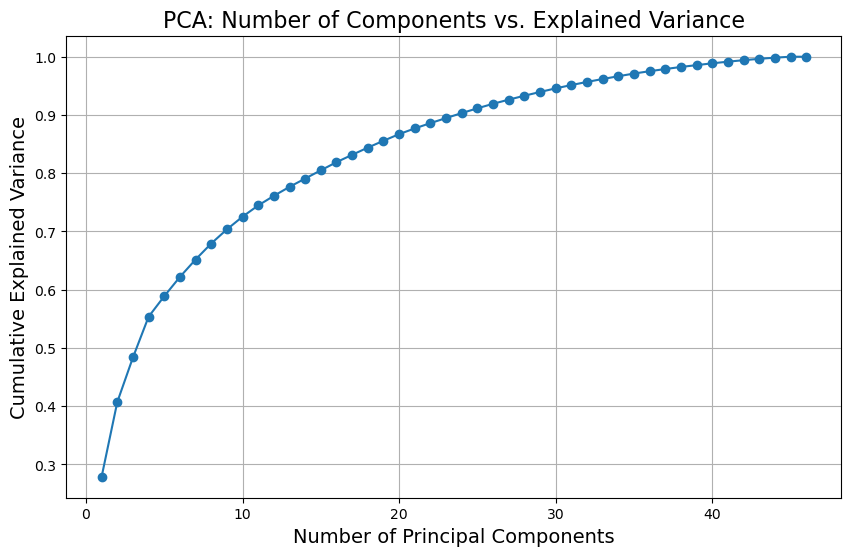

Principal Component 1: Feature 470 is the most important Depth 1, window 0, Interaction Term: (470,)
Principal Component 2: Feature 4974 is the most important Depth 1, window 2, Interaction Term: (462,)
Principal Component 3: Feature 1089 is the most important Depth 1, window 0, Interaction Term: (1089,)
Principal Component 4: Feature 12181 is the most important Depth 1, window 5, Interaction Term: (901,)
Principal Component 5: Feature 10071 is the most important Depth 1, window 4, Interaction Term: (1047,)
Principal Component 6: Feature 15353 is the most important Depth 1, window 6, Interaction Term: (1817,)
Principal Component 7: Feature 10889 is the most important Depth 1, window 4, Interaction Term: (1865,)
Principal Component 8: Feature 5566 is the most important Depth 1, window 2, Interaction Term: (1054,)
Principal Component 9: Feature 13299 is the most important Depth 1, window 5, Interaction Term: (2019,)
Principal Component 10: Feature 11585 is the most important Depth 1, win

Location 54 fluctuations: [1.350074052810669, 0.4368177056312561, 0.5054836273193359, 0.061536580324172974, 0.1529538333415985, 0.09855462610721588, 0.12873952090740204]
Location 60 fluctuations: [2.1112866401672363, 0.4148977994918823, 0.6918264031410217, 0.0843922570347786, 0.13589100539684296, 0.17192360758781433, 0.17485380172729492]
Location 816 fluctuations: [20.063926696777344, 18.014820098876953, 4.476986885070801, 17.38796615600586, 1.216092586517334, 1.6269067525863647, 1.2055299282073975]
Location 969 fluctuations: [16.802587509155273, 16.393373489379883, 4.315108299255371, 16.421798706054688, 1.4676753282546997, 1.6551226377487183, 1.0207078456878662]
Location 335 fluctuations: [10.335111618041992, 10.014293670654297, 2.3479435443878174, 11.189038276672363, 0.9633975028991699, 1.13616144657135, 1.0597538948059082]


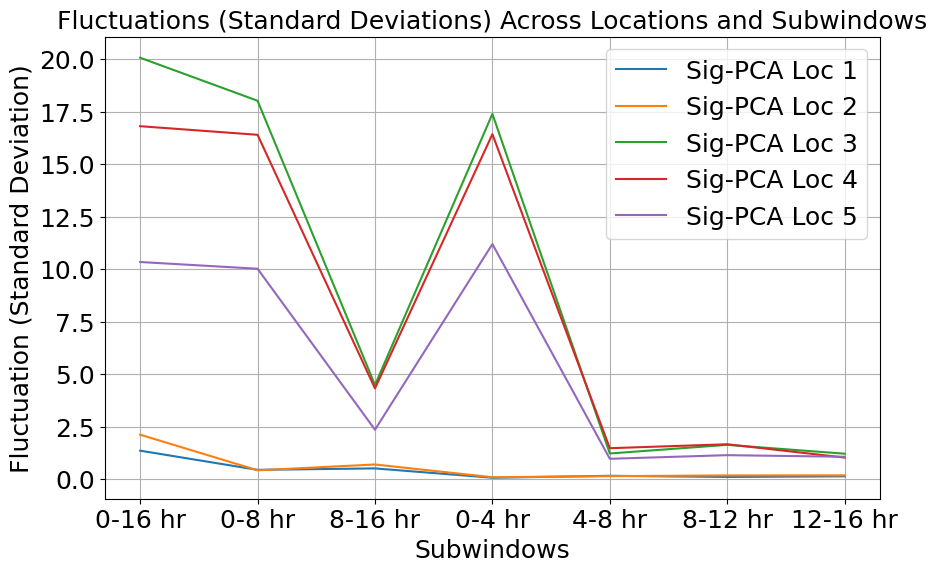

Test input shape nwp grid: torch.Size([153272, 1875])
Test output shape nwp grid: torch.Size([153272, 15])
Input shape: torch.Size([6118, 1875])
Output NWP at fixed grid shape: torch.Size([6118, 15])


NameError: name 'SimpleNNpos' is not defined

In [52]:
# Instantiate the ComputeWindowSignature class
compute_signature = ComputeWindowSignature(
    window_name='Dyadic',          # The windowing method to use
    window_kwargs={'depth': 2},    # Parameters for the windowing method
    ds_length=final_transformed_ts.shape[1] ,                 # Length of the dataset
    sig_tfm='signature',           # Use signature transformation
    depth=2,                       # Signature depth
    rescaling=None,                # Rescaling method
    normalisation=None             # Normalisation method
)

#see the windows in detail
dyadic_window_instance = window_getter('Dyadic', depth=2)
length =final_transformed_ts.shape[1] 
windows = dyadic_window_instance(length)
print(windows)
numwin= compute_signature.num_windows(final_transformed_ts.shape[1])
print(f"Total windows : {numwin}")

# Prepare the input path tensor
path = final_transformed_ts
signatures = compute_signature.forward(path)

# Print the signatures
print(f"Total signatures: len(signatures) ")

flattened_signatures = [signature for group in signatures for signature in group]
print(len(flattened_signatures))
# this is a list of length 7 corresponding to 7 windows,
#each element in the list has signature shape [46,3333]

stacked_signatures = torch.cat(flattened_signatures, dim=1)
print(stacked_signatures.shape)# concatenating all 7 signatures for all windows, first global, then half, then ...

smodule=signatory.signature_module
# Convert PyTorch tensor to NumPy for use with scikit-learn
flattened_signatures = [signature for group in signatures for signature in group]
columnwise_signatures = torch.cat(flattened_signatures, dim=1)
columnwise_signatures_np = columnwise_signatures.detach().cpu().numpy()
print(f'columnwise signatures: {columnwise_signatures_np.shape}')

stacked_signatures_np = stacked_signatures.detach().cpu().numpy()
print(f'Stacked signatures in numpy: {stacked_signatures_np.shape}')

scaler = StandardScaler()
signatures_np = scaler.fit_transform(stacked_signatures_np)

# Apply PCA to reduce dimensionality
pca = PCA()
pca.fit(signatures_np)
signatures_pca = pca.transform(signatures_np)
explained_variance = pca.explained_variance_ratio_
cumulative_explained_variance = explained_variance.cumsum()

num_components_95 =  next(i for i, total in enumerate(cumulative_explained_variance) if total > 0.995)+1

print(f"Number of components : {num_components_95}")
reduced_space= signatures_pca[:,:num_components_95]
print(f'PCA Reduced space: {reduced_space.shape}')


# Plot variance explained vs. number of components
plt.figure(figsize=(10, 6))
plt.plot(np.arange(1, len(explained_variance) + 1), cumulative_explained_variance, marker='o', linestyle='-')
plt.xlabel("Number of Principal Components", fontsize=14)
plt.ylabel("Cumulative Explained Variance", fontsize=14)
plt.title("PCA: Number of Components vs. Explained Variance", fontsize=16)
plt.grid()
plt.show()

components = pca.components_
unique_interaction_terms = set()

for i, component in enumerate(components):
    most_contributing_feature =np.argmax(np.abs(component))  # Get index of the highest absolute value
    win= most_contributing_feature // signatures[0][0].shape[1]
    col_within_window = most_contributing_feature % signatures[0][0].shape[1]

    depth, interaction_term = map_column_to_interaction(col_within_window, channels=3332, max_depth=2)
    unique_interaction_terms.add(interaction_term)

    print(f"Principal Component {i+1}: Feature {most_contributing_feature} is the most important Depth {depth}, window {win}, Interaction Term: {interaction_term}")

# Print unique interaction terms
print("\nUnique Interaction Terms:")
for term in unique_interaction_terms:
    print(term)


# Use a set to find unique values
unique_values = set()

# Iterate through the list and add values to the set
for term in unique_interaction_terms:
    unique_values.update(term)

# Convert the set back to a sorted list for better readability
unique_values = sorted(unique_values)

# Print the unique values
print("Unique Values:", unique_values)
print(len(unique_values))

# Initialize an empty list to store the sigpca values
sigpca_values = []

# Loop over each index in label_indices
for i in label_indices:
    # Compute or access the sigpca value for the current index
    sigpca = unique_values[i]  # Assuming unique_values[i] is the value you want
    sigpca_values.append(sigpca)


# Calculate the number of rows and columns for the subplots
depth = 3
num_depths = len(windows[0:depth])  # Number of depth levels
max_sub_windows = max(len(window_list) for window_list in windows[0:depth])  # Maximum number of sub-windows at any depth

# Create a figure with appropriate size
fig, axes = plt.subplots(num_depths, max_sub_windows, figsize=(100, 80), squeeze=False)

# Initialize subplot counter
sub_window_counter = 0

# Store labels for a shared legend
labels = [f'Sig-PCA Loc {i +1}' for i in range(len(label_indices))]  # Assuming at most 10 signature columns
#labels = [f'Sig-PCA Loc {i +1}' for i in range(len(unique_values))]  # Assuming at most 10 signature columns

# Initialize an empty dictionary to store the fluctuations for each location
fluctuations = {}

# Loop over each depth and its sub-windows
for depth_idx, window_list in enumerate(windows[0:depth]):
    print(f"Processing hierarchical dyadic window depth {depth_idx + 1} with {len(window_list)} sub-windows")
    
    for sub_window_idx, pair in enumerate(window_list):
        # Extract the start and end indices of the current sub-window
        start_idx, end_idx = pair.start, pair.end
        print(f"Sub-window {sub_window_idx + 1} : Start = {start_idx}, End = {end_idx}")

        # Extract the corresponding signature for the current window and sub-window (assuming signature is a PyTorch tensor)
        signature = signatures[depth_idx][sub_window_idx]

        # Calculate fluctuations for each location (standard deviation of signature terms)
        for i in sigpca_values:  # Ensure we don't exceed the number of columns in signature
            loc_fluctuation = signature[:, i].std().item()  # Standard deviation as the fluctuation measure
            if i not in fluctuations:
                fluctuations[i] = []
            fluctuations[i].append(loc_fluctuation)

        # for i in unique_values:  # Ensure we don't exceed the number of columns in signature
        #     loc_fluctuation = signature[:, i].std().item()  # Standard deviation as the fluctuation measure
        #     if i not in fluctuations:
        #         fluctuations[i] = []
        #     fluctuations[i].append(loc_fluctuation)


        # Plot the first 100 terms of the signature for this sub-window
        ax = axes[depth_idx, sub_window_idx]  # Get the corresponding subplot
        for i in sigpca_values:  # Ensure we don't exceed the number of columns in signature
            # Convert x-axis indices to time in hours, then to days
            num_rows=signature.shape[0]
            x_hours = np.arange(num_rows) * 15  # Each row represents 15 hours
            x_days = x_hours / 24  # Convert hours to days
            
            # Plot the first column of signature (or any specific column)
            ax.plot(x_days, signature[:, i].numpy())  # Plotting against days
            
            # Adjust x-axis ticks
            


            #ax.plot(signature[:, i])  # Convert to NumPy for plotting
        # for i in unique_values:  # Ensure we don't exceed the number of columns in signature
        #     ax.plot(signature[:, i].numpy())  # Convert to NumPy for plotting

    
        # Set title and labels with increased font sizes
        ax.set_xticks(np.arange(0, np.max(x_days) + 1, 5))  # Set major ticks at every 1 day
        ax.set_title(f'Sub-window {sub_window_idx + 1}\nHourly Steps {start_idx}-{end_idx}', fontsize=100)
        ax.set_xlabel('Days', fontsize=100)
        ax.set_ylabel('Signature Value', fontsize=100)

        # Increase tick label font size
        ax.tick_params(axis='both', which='major', labelsize=100)

# Remove empty subplots if there are any
for depth_idx in range(num_depths):
    for sub_window_idx in range(len(windows[depth_idx]), max_sub_windows):
        fig.delaxes(axes[depth_idx, sub_window_idx])

# Add a shared legend for the figure with increased font size
fig.legend(labels, loc='center right', fontsize=100, title="Signature Terms", title_fontsize=100, bbox_to_anchor=(0.9, 0.5))

# Adjust layout to avoid overlapping subplots
plt.tight_layout(rect=[0, 0, 0.9, 1])  # Leave space on the right for the legend
plt.savefig("nwpdepth2.pdf")
plt.show()

# Print the fluctuations for each location
for loc, fluct in fluctuations.items():
    print(f"Location {loc} fluctuations: {fluct}")

# Define the subwindow labels
subwindow_labels = ['0-16 hr', '0-8 hr', '8-16 hr', '0-4 hr', '4-8 hr', '8-12 hr', '12-16 hr']

# Create the plot
plt.figure(figsize=(10, 6))

# Loop through each location's fluctuations and plot
for i, (loc, fluct) in enumerate(fluctuations.items(), start=1):
    plt.plot(range(1, 8), fluct, label=f'Sig-PCA Loc {i}')

# Customize the plot
plt.title("Fluctuations (Standard Deviations) Across Locations and Subwindows", fontsize=18)
plt.xlabel("Subwindows", fontsize=18)
plt.ylabel("Fluctuation (Standard Deviation)", fontsize=18)
plt.xticks(range(1, 8), subwindow_labels, fontsize=18)
plt.yticks(fontsize=18)
plt.legend(loc="upper right", fontsize=18)
plt.grid(True)
plt.savefig("nwpdepth2fluctuations.pdf")
plt.show()

lon_sigpca_1=long_flat[unique_values]
lat_sigpca_1=lat_flat[unique_values]

# Test input
length=46

num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Romove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)


# Create augmented input
augmented_cols = []

for i in range(len(lat_flat)):
    chunk = reduced_space
    
    # Create an array of shape (length, 2) with lat_obs[i] and lon_obs[i]
    lat_lon_column = np.column_stack((np.full(length, lat_flat[i]), np.full(length, long_flat[i])))
    basiscolumn= np.tile(phigrid[i, :], (length, 1))
    # Concatenate the chunk with the lat/lon columns and the basis functions
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    
    # Append to the list of augmented rows
    augmented_cols.append(augmented_chunk)

# Combine all augmented rows back into one array
testinput = np.vstack(augmented_cols)
testinput_tensor = torch.tensor(testinput, dtype=torch.float32)
print(f"Test input shape nwp grid: {testinput_tensor.shape}")

testtarget_subset = np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
testtarget_tensor = torch.tensor(testtarget_subset, dtype=torch.float32)
print(f"Test output shape nwp grid: {testtarget_tensor.shape}")


# Training--# Define sample sizes
percent = 4
total_size = 3332
sample_size = round((percent / 100) * total_size)

mse_results = []
length=46
num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

# Randomly select a subset of lat/lon points
np.random.seed(4)
indices = np.random.choice(len(lat_flat), sample_size, replace=False)
lat_subset = lat_flat[indices]
long_subset = long_flat[indices]

llong=np.array(long_subset)
llat= np.array(lat_subset)

normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))

##Wendland kernel
basis_size = 0
phi = np.zeros((len(lat_subset), sum(num_basis)))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phi[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phi[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Romove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phi.shape[1]):
    if sum(phi[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phi_reduce = np.delete(phi,idx_zero,1)

# Prepare input data
augmented_cols = []
for i in range(sample_size):
    lat_lon_column = np.column_stack((np.full(length, lat_subset[i]), np.full(length, long_subset[i])))
    basis_column = np.tile(phi[i, :], (length, 1))
    augmented_chunk = np.hstack((reduced_space, lat_lon_column, basis_column))
    augmented_cols.append(augmented_chunk)

input_subset = np.vstack(augmented_cols)
target_subset = np.vstack([nwp_tensor[:, :, i] for i in indices])

# Convert to PyTorch tensors
inputs_tensor = torch.tensor(input_subset, dtype=torch.float32)
targets_tensor = torch.tensor(target_subset, dtype=torch.float32)
print(f'Input shape: {inputs_tensor.shape}')
print(f'Output NWP at fixed grid shape: {targets_tensor.shape}')

# Train the neural network
model = SimpleNNpos(input_subset.shape[1], target_subset.shape[1])
optimizer = optim.Adam(model.parameters(), lr=0.01)
criterion = nn.MSELoss()

num_epochs = 5000  # Reduce training iterations for efficiency
for epoch in range(num_epochs):
    optimizer.zero_grad()
    outputs = model(inputs_tensor)
    loss = criterion(outputs, targets_tensor)
    loss.backward()
    optimizer.step()
    if (epoch + 1) % 100 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')
        

# Evaluate model
with torch.no_grad():
    predictions_val = model(testinput_tensor)
mse = F.mse_loss(predictions_val, testtarget_tensor).item()
print(f"Sample size: {sample_size},  MSE between reconstructed NWP and true NWP entire grid: {mse:.4f}")

nwpgrid=np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
obsstack=np.vstack([obs_tensor[:, :, i] for i in range(obs_tensor.shape[2])])

obstestgrid = np.zeros((flattened_trimmed_nwp.shape[0], flattened_trimmed_nwp.shape[1]))
for i in range(flattened_trimmed_nwp.shape[0]):
    blocknwp = flattened_trimmed_nwp[i, :]
    flattened_series_nwp = blocknwp.flatten()

    blockpredsgrid = predictions_val[i*length:(i+1)*length, :]
    flattened_series_predsgrid = blockpredsgrid.flatten()
    obstestgrid[i, :] = flattened_series_predsgrid
print(obstestgrid.shape)

sigpca_dk_nwp_4percent_depth2=obstestgrid

mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.std(flattened_trimmed_nwp, axis=1)

mean_values_obs = np.mean(obstestgrid, axis=1)
variance_values_obs = np.std(obstestgrid, axis=1)

vmin = min(mean_values.min(), mean_values_obs.min())
vmax = max(mean_values.max(), mean_values_obs.max())

vminva = min(variance_values.min(), variance_values_obs.min())
vmaxva = max(variance_values.max(), variance_values_obs.max())


# Plot the mean heatmap using scatter
plt.figure(figsize=(12, 6))  
plt.subplot(1, 2, 1)
sc1=plt.scatter(long_flat, lat_flat, c=mean_values, cmap='rainbow', vmin=vmin, vmax=vmax)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Mean NWP')

plt.subplot(1, 2, 2)
sc2=plt.scatter(long_flat, lat_flat, c=mean_values_obs, cmap='rainbow', vmin=vmin, vmax=vmax)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc2,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Mean Recon NWP depth 2')

plt.tight_layout()
plt.show()


plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sc3=plt.scatter(long_flat, lat_flat, c=variance_values, cmap='rainbow',vmin=vminva, vmax=vmaxva)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc3,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Standard deviation NWP')

plt.subplot(1, 2, 2)
sc4=plt.scatter(long_flat, lat_flat, c=variance_values_obs, cmap='rainbow',vmin=vminva, vmax=vmaxva)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc4,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Standard deviation Recon NWP depth 2')
plt.tight_layout()
plt.show()

closest_lats = []
closest_lons = []
closest_indices = []
for latc, lonc in zip(lat_obs, lon_obs):
    # Calculate the distance to each station in lat_flat and long_flat
    distances = np.sqrt((lat_flat - latc)**2 + (long_flat - lonc)**2)
    closest_index = np.argmin(distances)  # Find the index of the minimum distance
    
    # Append the closest latitude, longitude, and index
    closest_lats.append(lat_flat [closest_index])
    closest_lons.append(long_flat[closest_index])
    closest_indices.append(closest_index)

# Convert to numpy arrays for easy handling
closest_lats = np.array(closest_lats)
closest_lons = np.array(closest_lons)
closest_indices = np.array(closest_indices)
print(len(closest_indices))

# Test input
length=46

num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Romove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)


# Create augmented input
augmented_cols = []

for i in range(len(lat_flat)):
    chunk = reduced_space
    
    # Create an array of shape (length, 2) with lat_obs[i] and lon_obs[i]
    lat_lon_column = np.column_stack((np.full(length, lat_flat[i]), np.full(length, long_flat[i])))
    basiscolumn= np.tile(phigrid[i, :], (length, 1))
    # Concatenate the chunk with the lat/lon columns and the basis functions
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    
    # Append to the list of augmented rows
    augmented_cols.append(augmented_chunk)

# Combine all augmented rows back into one array
testinput = np.vstack(augmented_cols)
testinput_tensor = torch.tensor(testinput, dtype=torch.float32)
print(f"Test input shape nwp grid: {testinput_tensor.shape}")

testtarget_subset = np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
testtarget_tensor = torch.tensor(testtarget_subset, dtype=torch.float32)
print(f"Test output shape nwp grid: {testtarget_tensor.shape}")

num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

llong=np.array(lon_obs)
llat= np.array(lat_obs)

normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))

##Wendland kernel
basis_size = 0
phi = np.zeros((len(lat_obs), sum(num_basis)))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phi[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phi[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

idx_zero = np.array([], dtype=int)
for i in range(phi.shape[1]):
    if sum(phi[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phi_reduce = np.delete(phi,idx_zero,1)


num_basis = [10**2,19**2,37**2]

phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)

length=nwp_tensor.shape[0]
augmented_cols = []
for i in range(len(lat_obs)):
    chunk = reduced_space
    lat_lon_column = np.column_stack((np.full(length, lat_obs[i]), np.full(length, lon_obs[i])))
    basiscolumn= np.tile(phi[i, :], (length, 1))
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    augmented_cols.append(augmented_chunk)

input = np.vstack(augmented_cols)
print(f'Training on OBS lat long and sig PCA: {input.shape}')

recon_nwp_3332=np.zeros(nwp_tensor.shape)
for i in range(nwp_tensor.shape[2]):
    recon_nwp_3332[:, :, i] = torch.from_numpy(sigpca_dk_nwp_4percent_depth2[i, :].reshape(nwp_tensor.shape[0],nwp_tensor.shape[1])).float()
print(f'Shape of reconstructed NWP : {recon_nwp_3332.shape}')

recon_nwp_3332_closestin=np.vstack([recon_nwp_3332[:, :, i] for i in closest_indices])
print(f'Shape of reconstructed NWP at obs locations: {recon_nwp_3332_closestin.shape}')

# output is OBS-reconstructed NWP[ closest indices]
output= obsstack-recon_nwp_3332_closestin
print(f'Correction output: {output.shape}')

input_size = input.shape[1]
output_size = output.shape[1]


nwpobsgrid=nwp_tensor[:,:,closest_indices]
print(f'nwpobsgrid shape: {nwpobsgrid.shape}')
nwpstack=np.vstack([nwpobsgrid[:, :, i] for i in range(nwpobsgrid.shape[2])])
print(f"NWP stacked shape: {nwpstack.shape}") 
nwpstacktensor= torch.tensor(nwpstack, dtype=torch.float32)
print(f"NWP stacked tensor shape: {nwpstacktensor.shape}") 


model = SimpleNN(input_size,output_size)

optimizer = optim.Adam(model.parameters(), lr=0.01) #0.01 is good

inputs_tensor=torch.tensor(input, dtype=torch.float32)
print(f"Input shape: {inputs_tensor.shape}")
targets_tensor=torch.tensor(output, dtype=torch.float32)
print(f"Output shape : {targets_tensor.shape}")

num_epochs = 5000

for epoch in range(num_epochs):
    optimizer.zero_grad()  
    outputs = model(inputs_tensor) 
    loss = custom_loss(outputs, targets_tensor,nwpstacktensor)
    loss.backward()  
    optimizer.step()  
    if (epoch + 1) % 100 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')
        

with torch.no_grad(): 
    predictions = model(testinput_tensor) 

targets_np = targets_tensor.cpu().numpy() 
predictions_np = predictions.cpu().numpy() 


obstestgrid_recon = np.zeros((flattened_trimmed_nwp.shape[0], flattened_trimmed_nwp.shape[1]))

for i in range(flattened_trimmed_nwp.shape[0]):
    blocknwp = sigpca_dk_nwp_4percent_depth2[i, :]
    flattened_series_nwp_recon = blocknwp.flatten()

    blockpredsgrid = predictions_np[i*length:(i+1)*length, :]
    flattened_series_predsgrid = blockpredsgrid.flatten()

    obstestgrid_recon[i, :] = flattened_series_nwp_recon + flattened_series_predsgrid

print(obstestgrid_recon.shape)

sigpca_dk_grid_corr_4percent_depth2=obstestgrid_recon

mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.std(flattened_trimmed_nwp, axis=1)

mean_values_obs = np.mean(obstestgrid_recon, axis=1)
variance_values_obs = np.std(obstestgrid_recon, axis=1)

vmin = min(mean_values.min(), mean_values_obs.min())
vmax = max(mean_values.max(), mean_values_obs.max())

vminva = min(variance_values.min(), variance_values_obs.min())
vmaxva = max(variance_values.max(), variance_values_obs.max())


# Plot the mean heatmap using scatter
plt.figure(figsize=(12, 6))  
plt.subplot(1, 2, 1)
sc1=plt.scatter(long_flat, lat_flat, c=mean_values, cmap='rainbow', vmin=vmin, vmax=vmax)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Mean NWP')

plt.subplot(1, 2, 2)
sc2=plt.scatter(long_flat, lat_flat, c=mean_values_obs, cmap='rainbow', vmin=vmin, vmax=vmax)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc2,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Mean ASOS corrected Recon NWP')

plt.tight_layout()
plt.show()


plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sc3=plt.scatter(long_flat, lat_flat, c=variance_values, cmap='rainbow',vmin=vminva, vmax=vmaxva)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc3,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Standard deviation NWP')

plt.subplot(1, 2, 2)
sc4=plt.scatter(long_flat, lat_flat, c=variance_values_obs, cmap='rainbow',vmin=vminva, vmax=vmaxva)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc4,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Standard deviation ASOS corrected Recon NWP')
plt.tight_layout()
plt.show()


In [56]:
# np.save("sigpca_dk_nwp_4percent_depth2.npy", sigpca_dk_nwp_4percent_depth2)
# np.save("sigpca_dk_grid_corr_4percent_depth2.npy", sigpca_dk_grid_corr_4percent_depth2)

sigpca_dk_nwp_4percent_depth2= np.load(  "sigpca_dk_nwp_4percent_depth2.npy")
sigpca_dk_grid_corr_4percent_depth2 = np.load("sigpca_dk_grid_corr_4percent_depth2.npy")

# plot comparisons

In [59]:
print(selected_lats)
print(selected_lons)

NameError: name 'selected_lats' is not defined

/var/folders/b5/7ttzcvrn2mngkw42xq19k9m1cmzbbx/T/ipykernel_25251/3567093325.py:115: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0, 0])  # Adjust space for colorbar and legend
/var/folders/b5/7ttzcvrn2mngkw42xq19k9m1cmzbbx/T/ipykernel_25251/3567093325.py:115: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout(rect=[0, 0, 0, 0])  # Adjust space for colorbar and legend


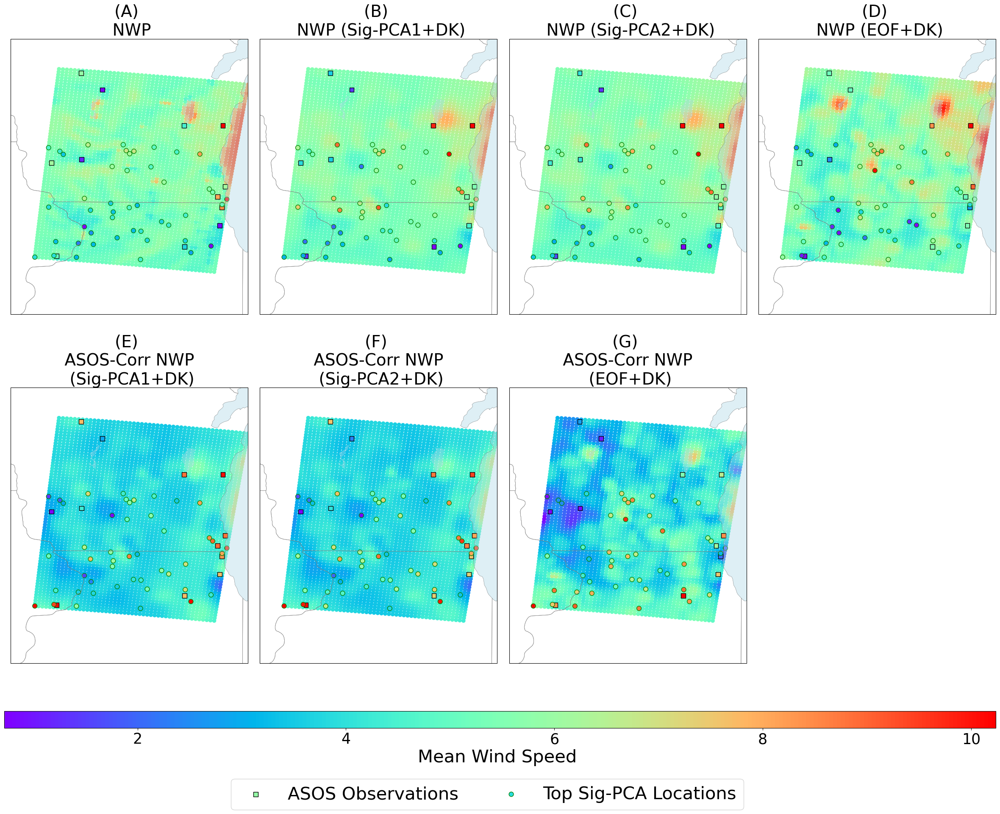

/var/folders/b5/7ttzcvrn2mngkw42xq19k9m1cmzbbx/T/ipykernel_25251/3567093325.py:174: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0,0,0])  # Adjust space for colorbar and legend
/var/folders/b5/7ttzcvrn2mngkw42xq19k9m1cmzbbx/T/ipykernel_25251/3567093325.py:174: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout(rect=[0, 0,0,0])  # Adjust space for colorbar and legend


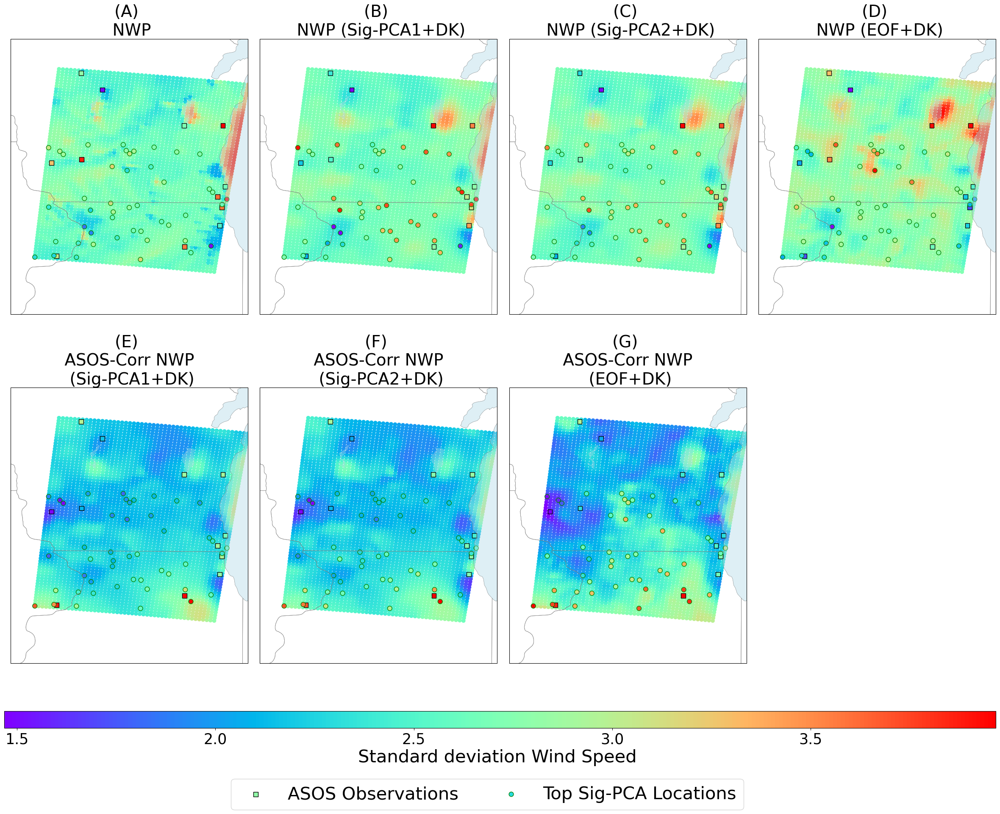

In [75]:
latdepth1=lat_flat[unique_values]
londepth1=long_flat[unique_values]

mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.std(flattened_trimmed_nwp, axis=1)

mean_values_obs_sigpca1 = np.mean(sigpca_dk_nwp_4percent, axis=1)
variance_values_obs_sigpca1 = np.std(sigpca_dk_nwp_4percent, axis=1)

mean_values_obs_sigpca1_dk = np.mean(sigpca_dk_grid_corr_4percent, axis=1)
variance_values_obs_sigpca1_dk = np.std(sigpca_dk_grid_corr_4percent, axis=1)

mean_values_obs_sigpca2_dk = np.mean(sigpca_dk_grid_corr_4percent_depth2, axis=1)
variance_values_obs_sigpca2_dk = np.std(sigpca_dk_grid_corr_4percent_depth2, axis=1)

mean_values_obs_sigpca2 = np.mean(sigpca_dk_nwp_4percent_depth2, axis=1)
variance_values_obs_sigpca2 = np.std(sigpca_dk_nwp_4percent_depth2, axis=1)

mean_values_eof_dk= np.mean(eof_dk_nwp_4percent, axis=1)
variance_values_eof_dk = np.std(eof_dk_nwp_4percent, axis=1)

mean_values_obs_eof_dk = np.mean(eof_dk_grid_corr_4percent, axis=1)
variance_values_obs_eof_dk = np.std(eof_dk_grid_corr_4percent, axis=1)

vmin = min(mean_values.min(),mean_values_obs_sigpca1.min(),mean_values_obs_sigpca1_dk.min(),mean_values_eof_dk.min(), mean_values_obs_eof_dk.min(), mean_values_obs_sigpca2.min(), mean_values_obs_sigpca2_dk.min())
vmax = max(mean_values.max(),mean_values_obs_sigpca1.max(),mean_values_obs_sigpca1_dk.max(),mean_values_eof_dk.max(), mean_values_obs_eof_dk.max(), mean_values_obs_sigpca2.max(), mean_values_obs_sigpca2_dk.max())

vminva = min(variance_values.min(),variance_values_obs_sigpca1.min(),variance_values_obs_sigpca1_dk.min(),variance_values_eof_dk.min(),  variance_values_obs_eof_dk.min(),variance_values_obs_sigpca2_dk.min(),variance_values_obs_sigpca2.min())
vmaxva = max(variance_values.max(),variance_values_obs_sigpca1.max(), variance_values_obs_sigpca1_dk.max(),variance_values_eof_dk.max(), variance_values_obs_eof_dk.max(),variance_values_obs_sigpca2_dk.max(),variance_values_obs_sigpca2.max())


nearest_indices_obs = []

for lat_o, lon_o in zip(lat_obs, lon_obs):
    distances = np.sqrt((lat_flat - lat_o) ** 2 + (long_flat - lon_o) ** 2)
    
    nearest_index = np.argmin(distances)
    nearest_indices_obs.append(nearest_index)

# Function to create each subplot
def plot_subplot(ax, lon_min, lon_max, lat_min, lat_max, lon_points_wi, lat_points_wi, 
                 data_values, longitudes_obs, latitudes_obs, data_values_obs, data_values_depth1,
                 cmap, vmin, vmax, title, show_legend=False):

    ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=1, edgecolor='black')
    ax.add_feature(cfeature.STATES, edgecolor='gray', linewidth=0.5)
    ax.add_feature(cfeature.LAKES, facecolor='lightblue', alpha=0.4)  # Lakes with transparency

    # Scatter plots
    sc = ax.scatter(lon_points_wi, lat_points_wi, c=data_values, cmap=cmap, vmin=vmin, vmax=vmax, 
                    transform=ccrs.PlateCarree())
    obs_scatter = ax.scatter(longitudes_obs, latitudes_obs, c=data_values_obs, cmap=cmap, edgecolors='black', 
                              marker='s', s=60, label='ASOS Observations', transform=ccrs.PlateCarree())
    depth_scatter = ax.scatter(londepth1, latdepth1, c=data_values_depth1, cmap=cmap, edgecolors='green', 
                                marker='o', s=60, label='Top Sig-PCA Locations', transform=ccrs.PlateCarree())

    # Zoom into the region of interest
    ax.set_extent([lon_min-0.4, lon_max, lat_min-0.7, lat_max+0.5], crs=ccrs.PlateCarree())

    # Customize the axes
    ax.set_title(title, fontsize=28)
    
    return sc, obs_scatter, depth_scatter

# Create figure and subplots with 1 row and 3 columns
fig, axes = plt.subplots(2,4, figsize=(30,20), subplot_kw={'projection': ccrs.PlateCarree()})

# Define dataset mappings for the subplots
datasets = [
    (mean_values, '(A) \n NWP'),
    (mean_values_obs_sigpca1, '(B) \n NWP (Sig-PCA1+DK)'),
    (mean_values_obs_sigpca2, '(C) \n NWP (Sig-PCA2+DK)'),
    (mean_values_eof_dk, '(D) \n NWP (EOF+DK)'),
    (mean_values_obs_sigpca1_dk, '(E) \n ASOS-Corr NWP \n (Sig-PCA1+DK)'),
    (mean_values_obs_sigpca2_dk, '(F) \n ASOS-Corr NWP \n (Sig-PCA2+DK)'),
    (mean_values_obs_eof_dk, '(G) \n ASOS-Corr NWP \n (EOF+DK)')
]

# Loop through datasets and create subplots
sc_list = []
legend_handles = None  # Store legend handles

for i, (data_values, title) in enumerate(datasets):
    ax = axes.flat[i]  # Use `flat[i]` to correctly index 2D axes array

    data_values_obs = data_values[nearest_indices_obs]
    data_values_depth1 = data_values[unique_values]
    
    sc, obs_scatter, depth_scatter = plot_subplot(
        ax, lon_min, lon_max, lat_min, lat_max, 
        long_flat, lat_flat, data_values, lon_obs, lat_obs, data_values_obs, data_values_depth1, 
        'rainbow', vmin, vmax, title
    )
    
    sc_list.append(sc)
    if legend_handles is None:
        legend_handles = [obs_scatter, depth_scatter]  # Store legend handles
fig.delaxes(axes.flat[-1])  # Remove empty subplot if not used
#fig.delaxes(axes.flat[-2])  # Remove empty subplot if not used


# Add a shared colorbar at the bottom
cbar_ax = fig.add_axes([0.12, 0.05, 0.78, 0.02])  # Adjust position and size
cbar = fig.colorbar(sc_list[0], cax=cbar_ax, orientation='horizontal', label='Mean Wind Speed ')
cbar.ax.xaxis.label.set_fontsize(30)  # Increase label font size
cbar.ax.tick_params(labelsize=25)  # Increase tick font size

# Reduce gaps between subplots
plt.subplots_adjust(hspace=0.15, wspace=0.05)  # Adjust spacing between subplots

# Place legend below the colorbar, without too much white space
fig.legend(handles=legend_handles, loc='upper center', fontsize=30, bbox_to_anchor=(0.5, -0.01), borderaxespad=0., ncol=3)

# Adjust layout for readability, make room for colorbar and legend
plt.tight_layout(rect=[0, 0, 0, 0])  # Adjust space for colorbar and legend

# Save the plot
plt.savefig("reconnwp_meancomparison.pdf", dpi=300, bbox_inches="tight", pad_inches=0.2)

plt.show()



# Create figure and subplots with 1 row and 3 columns
fig, axes = plt.subplots(2,4, figsize=(30,20), subplot_kw={'projection': ccrs.PlateCarree()})

# Define dataset mappings for the subplots
datasets = [
    (variance_values, '(A) \n NWP'),
    (variance_values_obs_sigpca1, '(B) \n NWP (Sig-PCA1+DK)'),
    (variance_values_obs_sigpca2, '(C) \n NWP (Sig-PCA2+DK)'),
    (variance_values_eof_dk, '(D) \n NWP (EOF+DK)'),

    (variance_values_obs_sigpca1_dk, '(E) \n ASOS-Corr NWP \n (Sig-PCA1+DK)'),
    (variance_values_obs_sigpca2_dk, '(F) \n ASOS-Corr NWP \n (Sig-PCA2+DK)'),
    (variance_values_obs_eof_dk, '(G) \n ASOS-Corr NWP \n (EOF+DK)')
]

# Loop through datasets and create subplots
sc_list = []
legend_handles = None  # Store legend handles

for i, (data_values, title) in enumerate(datasets):
    ax = axes.flat[i]  # Use `flat[i]` to correctly index 2D axes array

    data_values_obs = data_values[nearest_indices_obs]
    data_values_depth1 = data_values[unique_values]
    
    sc, obs_scatter, depth_scatter = plot_subplot(
        ax, lon_min, lon_max, lat_min, lat_max, 
        long_flat, lat_flat, data_values, lon_obs, lat_obs, data_values_obs, data_values_depth1, 
        'rainbow', vminva, vmaxva, title
    )
    
    sc_list.append(sc)
    if legend_handles is None:
        legend_handles = [obs_scatter, depth_scatter]  # Store legend handles
fig.delaxes(axes.flat[-1])  # Remove empty subplot if not used
#fig.delaxes(axes.flat[-2])  # Remove empty subplot if not used

# Add a shared colorbar at the bottom
cbar_ax = fig.add_axes([0.12, 0.05, 0.78, 0.02])  # Adjust position and size
cbar = fig.colorbar(sc_list[0], cax=cbar_ax, orientation='horizontal', label='Standard deviation Wind Speed ')
cbar.ax.xaxis.label.set_fontsize(30)  # Increase label font size
cbar.ax.tick_params(labelsize=25)  # Increase tick font size

# Reduce gaps between subplots
plt.subplots_adjust(hspace=0.15, wspace=0.05)  # Adjust spacing between subplots

# Place legend below the colorbar, without too much white space
fig.legend(handles=legend_handles, loc='upper center', fontsize=30, bbox_to_anchor=(0.5, -0.01), borderaxespad=0., ncol=3)

# Adjust layout for readability, make room for colorbar and legend
plt.tight_layout(rect=[0, 0,0,0])  # Adjust space for colorbar and legend

# Save the plot
plt.savefig("reconnwp_stdcomparison.pdf", dpi=300, bbox_inches="tight", pad_inches=0.2)

plt.show()



# Plot time series

In [77]:
nwpgrid=np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
obsstack=np.vstack([obs_tensor[:, :, i] for i in range(obs_tensor.shape[2])])


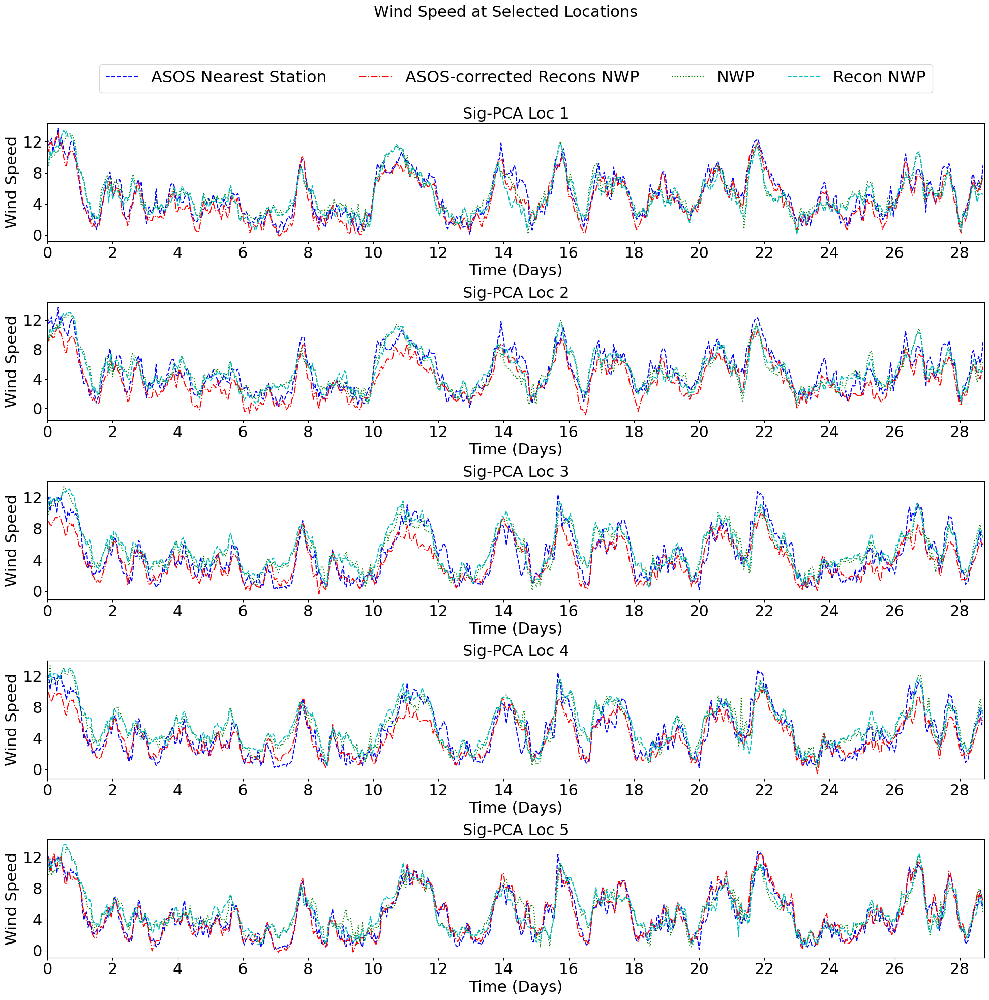

In [85]:
selected_lons = [long_flat[i] for i in sigpca_values]
selected_lats = [lat_flat[i] for i in sigpca_values]

fig, axs = plt.subplots(5, 1, figsize=(20, 20))  # Create a single figure with 5 subplots
fig.suptitle("Wind Speed at Selected Locations", fontsize=22)  

for idx, (lat, lon) in enumerate(zip(selected_lats, selected_lons)):
    if idx >= 5:  # Only plot the first 5 locations
        break

    # Find the nearest observation index and grid index
    obs_idx = np.argmin((lat_obs - lat)**2 + (lon_obs - lon)**2)
    loc_idx = sigpca_values[idx]

    length = nwp_tensor.shape[0]
    flattened_series_nwp_orig = nwpgrid[loc_idx * length : (loc_idx + 1) * length, :].flatten()
    flattened_series_obs_nearest = obsstack[obs_idx * length : (obs_idx + 1) * length, :].flatten()
    flattened_series_recon_nwp_sigpcadk = sigpca_dk_nwp_4percent[loc_idx, :].flatten()
    flattened_series_recon_asos_sigpcadk = sigpca_dk_grid_corr_4percent[loc_idx, :].flatten()

    colors = ['b', 'r', 'g', 'm', 'c']
    linestyles = ['--', '-.', ':', '-', '--']
    
    axs[idx].plot(flattened_series_obs_nearest, label="ASOS Nearest Station", 
                  color=colors[0], linestyle=linestyles[0])
    axs[idx].plot(flattened_series_recon_asos_sigpcadk, label="ASOS-corrected Recons NWP", 
                  color=colors[1], linestyle=linestyles[1])
    axs[idx].plot(flattened_series_nwp_orig, label="NWP", 
                  color=colors[2], linestyle=linestyles[2])
    axs[idx].plot(flattened_series_recon_nwp_sigpcadk, label="Recon NWP", 
                  color=colors[4], linestyle=linestyles[4])

    xtick_positions = np.arange(0, len(flattened_series_obs_nearest), 48)
    xtick_labels = [f"{i}" for i in range(0, len(xtick_positions) * 2, 2)]

    axs[idx].set_xticks(xtick_positions)
    axs[idx].set_xticklabels(xtick_labels, fontsize=22)
    axs[idx].set_xlim(0, len(flattened_series_obs_nearest))
    axs[idx].set_xlabel("Time (Days)", fontsize=22)
    axs[idx].set_ylabel("Wind Speed", fontsize=22)
    axs[idx].tick_params(axis='y', labelsize=22)

# Adjust y-ticks to show a reasonable range, automatically determined
    axs[idx].yaxis.set_major_locator(plt.MaxNLocator(nbins=5))  # Adjust the number of ticks as needed


    #axs[0].legend(fontsize=23, loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
    axs[0].legend(fontsize=23, loc='upper center', bbox_to_anchor=(0.5, 1.5), ncol=5, borderaxespad=0.)
    axs[idx].set_title(f"Sig-PCA Loc {idx + 1}", fontsize=22)


plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.savefig("wind_speed_subplots.pdf", dpi=300, bbox_inches="tight")
plt.show()


# qq plot

In [122]:
print(lcd_obs)
closest_lats = []
closest_lons = []
closest_indices = []
for latc, lonc in zip(lat_obs, lon_obs):
    # Calculate the distance to each station in lat_flat and long_flat
    distances = np.sqrt((lat_flat - latc)**2 + (long_flat - lonc)**2)
    closest_index = np.argmin(distances)  # Find the index of the minimum distance
    
    # Append the closest latitude, longitude, and index
    closest_lats.append(lat_flat [closest_index])
    closest_lons.append(long_flat[closest_index])
    closest_indices.append(closest_index)

# Convert to numpy arrays for easy handling
closest_lats = np.array(closest_lats)
closest_lons = np.array(closest_lons)
closest_indices = np.array(closest_indices)
print(closest_indices)
print(sigpca_dk_grid_corr_4percent[closest_indices,:].shape)

[[ 9.611537   9.380037  10.451797  ...  4.381352   4.4242225  4.287037 ]
 [ 7.3479815  8.308278   8.111074  ...  3.3953333  3.4982224  3.558241 ]
 [ 8.119648   8.402593   8.196815  ...  5.2387595  6.730648   5.9589815]
 ...
 [12.18376   11.943686  10.254593  ...  7.750963   5.7189074  5.9504075]
 [ 8.153945   7.5709076  7.7852592 ...  5.8560925  6.361963   6.482    ]
 [12.432407  11.583574  11.815074  ...  6.0875926  6.9107037  8.9256115]]
[3240 3001 2533 1667 1773 2592 1517 1368 1174  431  880   55]
(12, 690)


In [124]:
np.mean(np.sqrt(np.mean(np.square(sigpca_dk_grid_corr_4percent[closest_indices,:]-lcd_obs),axis=1))/ np.mean(lcd_obs,axis=1)*100)

24.849113600577144

[11 11  9  9  9]


/var/folders/b5/7ttzcvrn2mngkw42xq19k9m1cmzbbx/T/ipykernel_25251/3318148584.py:76: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout(rect=[0, 1, 1, 1])  # Leave space for the overall title


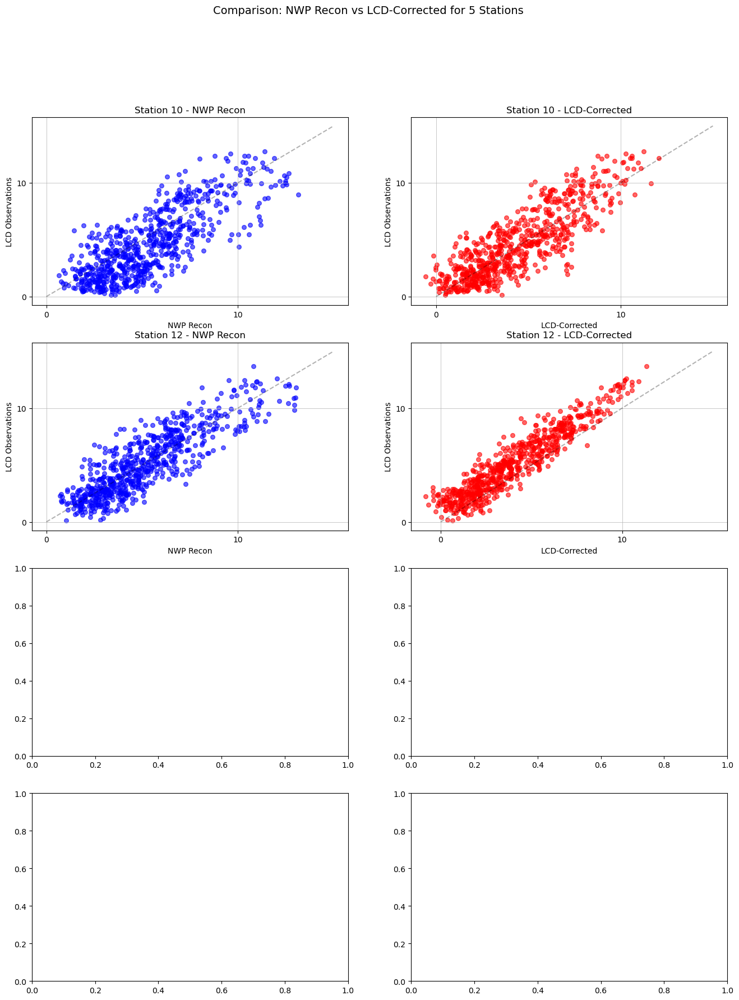

In [90]:
closest_lats = []
closest_lons = []
closest_indices = []
for latc, lonc in zip(selected_lats, selected_lons):
    # Calculate the distance to each station in lat_flat and long_flat
    distances = np.sqrt((lat_obs - latc)**2 + (lon_obs - lonc)**2)
    closest_index = np.argmin(distances)  # Find the index of the minimum distance
    
    # Append the closest latitude, longitude, and index
    closest_lats.append(lat_flat [closest_index])
    closest_lons.append(long_flat[closest_index])
    closest_indices.append(closest_index)

# Convert to numpy arrays for easy handling
closest_lats = np.array(closest_lats)
closest_lons = np.array(closest_lons)
closest_indices_highlighted = np.array(closest_indices)
print(closest_indices_highlighted)

residuals = [
    sigpca_dk_nwp_4percent[closest_indices_highlighted, :],
    sigpca_dk_grid_corr_4percent[closest_indices_highlighted, :]
]

uc= np.unique(closest_indices_highlighted)
# Define colors for each method
colors = ["blue", "green"]

obs_np=obs_tensor.view(obs_tensor.shape[0] * obs_tensor.shape[1], obs_tensor.shape[2]).numpy()
lcd_obs = obs_np.T  # Transpose to match dimensions


# Create a figure with 5 rows and 2 columns (for each method and station)
fig, axes = plt.subplots(4, 2, figsize=(16, 20))  # 5 rows (stations) and 2 columns (methods)
axes = axes.flatten()  # Flatten the 2D array for easier indexing

# Loop through each station (5 stations) and plot residuals for both methods (2 methods)
for i, station_idx in enumerate(uc):
     # Get the current axis for each column (first column for NWP Recon, second for LCD-Corrected)
    ax_nwp = axes[i * 2]  # NWP Recon will be in the first column
    ax_lcd = axes[i * 2 + 1]  # LCD-Corrected will be in the second column

    # Plot for NWP Recon residuals (in the first column)
    ax_nwp.scatter(sigpca_dk_nwp_4percent[station_idx, :], lcd_obs[station_idx, :], alpha=0.6, color='blue', label="NWP Recon", s=30)
    ax_nwp.set_xlabel("NWP Recon", fontsize=10)
    ax_nwp.set_ylabel("LCD Observations", fontsize=10)
    ax_nwp.set_title(f"Station {station_idx + 1} - NWP Recon", fontsize=12)
    
    # Add the y = x line for comparison
    ax_nwp.plot([0,15], [0,15], color='black', linestyle='--', alpha=0.3)  # Diagonal line
    
    # Enable grid and add horizontal and vertical gridlines
    ax_nwp.grid(True, which='both', linestyle='-', linewidth=0.5)
    ax_nwp.set_xticks(np.arange(0,15, 10))  # Adjust x-axis tick marks
    ax_nwp.set_yticks(np.arange(0,15, 10))  # Adjust y-axis tick marks
    
    # Plot for LCD-Corrected residuals (in the second column)
    ax_lcd.scatter(sigpca_dk_grid_corr_4percent[station_idx, :], lcd_obs[station_idx, :], alpha=0.6, color='red', label="LCD-Corrected", s=30)
    ax_lcd.set_xlabel("LCD-Corrected", fontsize=10)
    ax_lcd.set_ylabel("LCD Observations", fontsize=10)
    ax_lcd.set_title(f"Station {station_idx + 1} - LCD-Corrected", fontsize=12)
    
    # Add the y = x line for comparison
    ax_lcd.plot([0,15], [0,15], color='black', linestyle='--', alpha=0.3)  # Diagonal line
    
    # Enable grid and add horizontal and vertical gridlines
    ax_lcd.grid(True, which='both', linestyle='-', linewidth=0.5)
    ax_lcd.set_xticks(np.arange(0,15, 10))  # Adjust x-axis tick marks
    ax_lcd.set_yticks(np.arange(0,15, 10))  # Adjust y-axis tick marks


# Add the overall title for the whole figure
fig.suptitle("Comparison: NWP Recon vs LCD-Corrected for 5 Stations", fontsize=14)

# Adjust layout
plt.tight_layout(rect=[0, 1, 1, 1])  # Leave space for the overall title
# Save the plot
plt.savefig("nwp_residuals_qq_plots.pdf", dpi=150, bbox_inches="tight")

# Show the plot
plt.show()



12


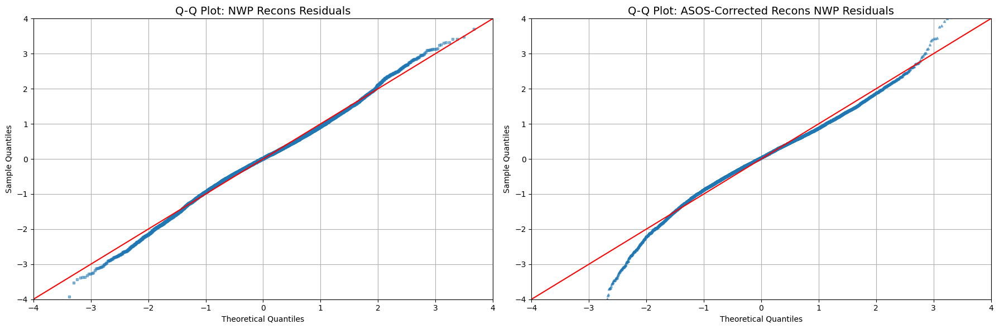

In [92]:
obs_np=obs_tensor.view(obs_tensor.shape[0] * obs_tensor.shape[1], obs_tensor.shape[2]).numpy()

closest_lats = []
closest_lons = []
closest_indices = []
for latc, lonc in zip(lat_obs, lon_obs):
    # Calculate the distance to each station in lat_flat and long_flat
    distances = np.sqrt((lat_flat - latc)**2 + (long_flat - lonc)**2)
    closest_index = np.argmin(distances)  # Find the index of the minimum distance
    
    # Append the closest latitude, longitude, and index
    closest_lats.append(lat_flat [closest_index])
    closest_lons.append(long_flat[closest_index])
    closest_indices.append(closest_index)

# Convert to numpy arrays for easy handling
closest_lats = np.array(closest_lats)
closest_lons = np.array(closest_lons)
closest_indices = np.array(closest_indices)
print(len(closest_indices))
lcd_obs = obs_np.T  # Transpose to match dimensions

# Compute residuals
residuals_nldasrecon = lcd_obs - sigpca_dk_nwp_4percent[closest_indices, :]
residuals_lcdcorr = lcd_obs - sigpca_dk_grid_corr_4percent[closest_indices, :]

# Normalize residuals
normalized_residuals_nldasrecon = (residuals_nldasrecon - np.mean(residuals_nldasrecon)) / np.std(residuals_nldasrecon)
normalized_residuals_lcdcorr = (residuals_lcdcorr - np.mean(residuals_lcdcorr)) / np.std(residuals_lcdcorr)

# Flatten all residuals
flat_nldasrecon = normalized_residuals_nldasrecon.flatten()
flat_lcdcorr = normalized_residuals_lcdcorr.flatten()

# Create figure and subplots (1 row, 3 columns)
fig, axes = plt.subplots(1, 2, figsize=(18, 6))
# Q-Q Plot for NLDAS Recon residuals
sm.qqplot(flat_nldasrecon, line='45', alpha=0.5, marker='s', ax=axes[0], markersize=3)
axes[0].set_title("Q-Q Plot: NWP Recons Residuals", fontsize=14)
axes[0].set_xlim([-4,4])
axes[0].set_ylim([-4,4])
axes[0].grid(True)

# Q-Q Plot for LCD Corrected residuals
sm.qqplot(flat_lcdcorr, line='45', alpha=0.5, marker='^', ax=axes[1], markersize=3)
axes[1].set_title("Q-Q Plot: ASOS-Corrected Recons NWP Residuals", fontsize=14)
axes[1].set_xlim([-4,4])
axes[1].set_ylim([-4,4])
axes[1].grid(True)

# Adjust layout and save the figure
plt.tight_layout()
plt.savefig("nwp_residuals_qq_plots.pdf", dpi=150, bbox_inches="tight")
plt.show()


# Correlation

In [95]:
# Function to compute correlation matrix
def compute_correlation_matrix(data):
    return np.corrcoef(data)

# Compute distances between stations
lat_lon_array = np.column_stack((lat_flat, long_flat))
distances = pdist(lat_lon_array, metric='euclidean')
distances_matrix = squareform(distances)
distances_flat = distances_matrix.flatten()

# Function to flatten correlation matrices and apply distance mask
def flatten_and_mask(matrix):
    flat_corr = matrix.flatten()
    return flat_corr[distances_flat > 0], distances_flat[distances_flat > 0]

# Compute distances between stations
lat_lon_array_obs = np.column_stack((lat_obs, lon_obs))
distances_obs = pdist(lat_lon_array_obs, metric='euclidean')
distances_matrix_obs = squareform(distances_obs)
distances_flat_obs = distances_matrix_obs.flatten()

def flatten_and_mask_obs(matrix):
    flat_corr = matrix.flatten()
    return flat_corr[distances_flat_obs > 0], distances_flat_obs[distances_flat_obs > 0]
    

0
1
2


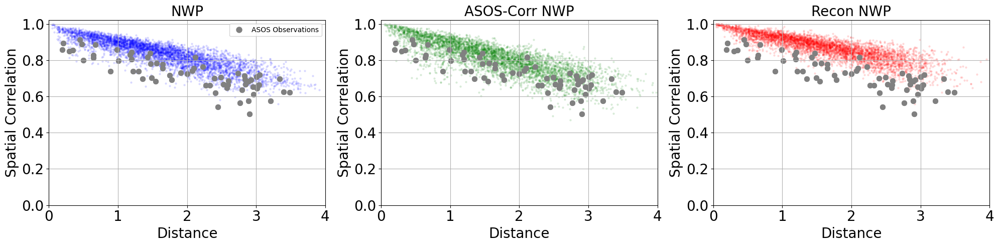

In [97]:
# Extract full dataset 
nwp_all = flattened_trimmed_nwp
corrected_all = sigpca_dk_grid_corr_4percent
recon_all = sigpca_dk_nwp_4percent
obs_stat=obs_np.T

# Compute correlation matrices
corr_matrix_model = compute_correlation_matrix(nwp_all)
corr_matrix_corrected = compute_correlation_matrix(corrected_all)
corr_matrix_recon = compute_correlation_matrix(recon_all)
corr_matrix_lcd = compute_correlation_matrix(obs_stat)

# Flatten and mask by distance
corr_model, distances_masked = flatten_and_mask(corr_matrix_model)
corr_corrected, _ = flatten_and_mask(corr_matrix_corrected)
corr_recon, _ = flatten_and_mask(corr_matrix_recon)
corr_lcd, distances_masked_obs = flatten_and_mask_obs(corr_matrix_lcd)

# Plotting
fig, axes = plt.subplots(1, 3, figsize=(20, 5))  # Single row, 4 columns
datasets = ["model", "corrected", "recon"]
colors = ["blue", "green", "red"]
titles = ["NWP", "ASOS-Corr NWP", "Recon NWP"]
lcd_black_label = "ASOS Observations"  # Label for black LCD dataset
lcd_black_color = "grey"  # Color for the black LCD dataset

legend_handle = Line2D([], [], marker='o', color='w', markerfacecolor=lcd_black_color, markersize=10, label=lcd_black_label)

for id,(ax, dataset, color, title) in enumerate(zip(axes, datasets, colors, titles)):
    print(id)
    # Random sampling for efficiency
    sample_size = min(5000, len(distances_masked))
    indices = np.random.choice(len(distances_masked), sample_size, replace=False)

    ax.scatter(distances_masked[indices], eval(f"corr_{dataset}")[indices], alpha=0.1, color=color, s=5)

    # For the black LCD dataset, ensure it uses its own indices (assumed to be "lcd_black_indices" in data)
    sample_sizeo = min(5000, len(distances_masked_obs))
    indiceso = np.random.choice(len(distances_masked_obs), sample_sizeo, replace=False)
    ax.scatter(distances_masked_obs[indiceso], corr_lcd[indiceso], color=lcd_black_color, s=50, label=lcd_black_label)
        

    ax.set_xlabel("Distance", fontsize=20)
    ax.set_ylabel("Spatial Correlation", fontsize=20)
    ax.set_title(title, fontsize=20)
    ax.grid(True)
    ax.set_xlim([0,4])
    ax.set_ylim([0,1.02])
    if id==0:
        ax.legend(handles=[legend_handle])  # Add the custom legend handle

    # Increase fontsize for x and y ticks
    ax.tick_params(axis='x', labelsize=20)
    ax.tick_params(axis='y', labelsize=20)



plt.tight_layout()
plt.savefig("nwp_correlation_distance_matrix.pdf", dpi=200, bbox_inches="tight")
plt.show()


# spectral comparison

/opt/anaconda3/lib/python3.12/site-packages/scipy/signal/_spectral_py.py:600: UserWarning: nperseg = 1024 is greater than input length  = 690, using nperseg = 690
  freqs, _, Pxy = _spectral_helper(x, y, fs, window, nperseg, noverlap,


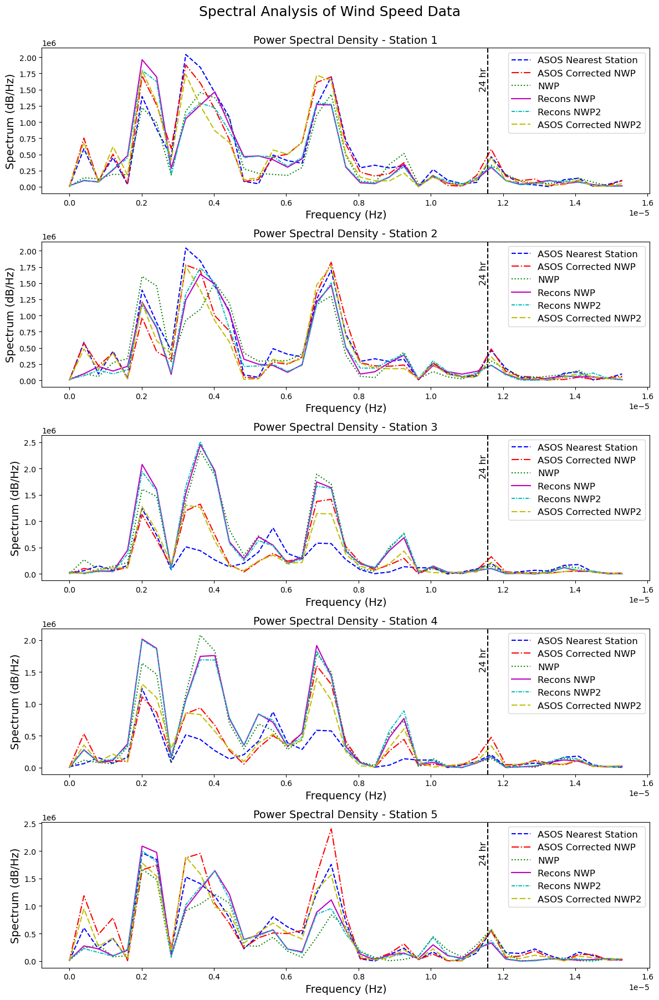

In [89]:
# Function to calculate and plot Power Spectral Density (PSD) using Welch's method
def plot_psd(ax, series, color, linestyle, label):
    f, Pxx = welch(series, fs=1/3600, nperseg=1024)  # 1 sample per hour
    mask = f <= 1/(18*3600)  # Limit to meaningful frequency range
    f_limit, Pxx_limit = f[mask], Pxx[mask]

    ax.plot(f_limit, Pxx_limit, color=color, linestyle=linestyle, label=label)
    ax.set_xlabel('Frequency (Hz)', fontsize=14)
    ax.set_ylabel('Spectrum (dB/Hz)', fontsize=14)
    ax.legend(fontsize=12)

colors = ['b', 'r', 'g', 'm', 'c', 'y']
linestyles = ['--', '-.', ':', '-', (0, (3, 1, 1, 1)), (0, (5, 2))]

# Select locations
selected_lons = [long_flat[i] for i in sigpca_values]
selected_lats = [lat_flat[i] for i in sigpca_values]

fig, axs = plt.subplots(5, 1, figsize=(12, 18))  # 5 stations, 1 column
fig.suptitle("Spectral Analysis of Wind Speed Data", fontsize=18, y=1)
plt.subplots_adjust(top=0.92)  # Adjust spacing between main title and subplots

for row_idx, (lat, lon) in enumerate(zip(selected_lats, selected_lons)):
    obs_idx = np.argmin((lat_obs - lat)**2 + (lon_obs - lon)**2)
    loc_idx = sigpca_values[row_idx]  
    length = nwp_tensor.shape[0]

    # Extract full time-series data (no seasonal slicing)
    flattened_series_nwp = nwpgrid[loc_idx * length : (loc_idx + 1) * length, :].flatten()
    flattened_series_obs_nearest = obsstack[obs_idx * length : (obs_idx + 1) * length, :].flatten()
    flattened_series_recon_nldas = sigpca_dk_nwp_4percent[loc_idx, :].flatten()
    flattened_series_recon_lcd = sigpca_dk_grid_corr_4percent[loc_idx, :].flatten()
    flattened_series_recon_nldas2 = sigpca_dk_nwp_4percent_depth2[loc_idx, :].flatten()
    flattened_series_recon_lcd2 = sigpca_dk_grid_corr_4percent_depth2[loc_idx, :].flatten()

    # Power Spectral Density (PSD) Plot
    plot_psd(axs[row_idx], flattened_series_obs_nearest, colors[0], linestyles[0], "ASOS Nearest Station")
    plot_psd(axs[row_idx], flattened_series_recon_lcd, colors[1], linestyles[1], "ASOS Corrected NWP")
    plot_psd(axs[row_idx], flattened_series_nwp, colors[2], linestyles[2], "NWP")
    plot_psd(axs[row_idx], flattened_series_recon_nldas, colors[3], linestyles[3], "Recons NWP")
    plot_psd(axs[row_idx], flattened_series_recon_nldas2, colors[4], linestyles[4], "Recons NWP2")
    plot_psd(axs[row_idx], flattened_series_recon_lcd2, colors[5], linestyles[5], "ASOS Corrected NWP2")


    # Adding vertical reference line for periodicities (24h)
    freq_24h = 1 / (24 * 3600)
    axs[row_idx].axvline(freq_24h, linestyle='--', color='black')
    axs[row_idx].text(freq_24h, axs[row_idx].get_ylim()[1] * 0.7, '24 hr', fontsize=12, horizontalalignment='right', rotation=90)

    axs[row_idx].set_title(f"Power Spectral Density - Station {row_idx + 1}", fontsize=14)

plt.tight_layout()
plt.savefig("spectral_analysis.pdf", dpi=300, bbox_inches="tight")
plt.show()
